Author: Darian Hadjiabadi | CS231N Final project

I want to generate realistic neuron morphologies. Here, I attempt to do this for the granule cells.
Specifically, this notebook covers the engineering steps necessary to train a respectable DGCAN model for generation
of realistic granule cell dendritic arborizations. Data is loaded in from the folder 'database-imgs-full/granule/train/a'.

In [5]:
import numpy as np
import sys
import os

import torch
import torch.nn as nn
from torch.nn import init
import torchvision
import torchvision.transforms as T
import torch.optim as optim
from torch.utils.data import DataLoader
from torch.utils.data import sampler
import torchvision.datasets as dset

from gan.network_utils import run_a_gan
from gan.network_utils import show_images
from gan.network_utils import initialize_weights
from gan.network_utils import gan_generate
from gan.network_utils import count_params
from gan.network_utils import save_model
from gan.network_utils import load_model
from gan.network import discriminator
from gan.network import dc_discriminator
from gan.network import vanilla_discriminator_loss
from gan.network import ls_discriminator_loss
from gan.network import generator
from gan.network import dc_generator
from gan.network import vanilla_generator_loss
from gan.network import ls_generator_loss

from gan.network import get_optimizer


import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
%matplotlib inline

%load_ext autoreload
%autoreload 2

plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'




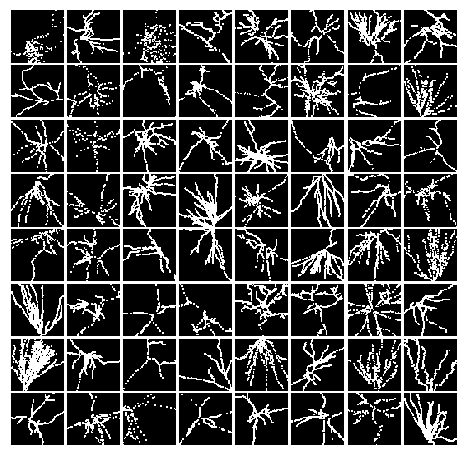

In [6]:
# ChunkSampler class taken from assignment3/GANs-PyTorch.ipynb

class ChunkSampler(sampler.Sampler):
    """Samples elements sequentially from some offset. 
    Arguments:
        num_samples: # of desired datapoints
        start: offset where we should start selecting from
    """
    def __init__(self, num_samples, start=0):
        self.num_samples = num_samples
        self.start = start

    def __iter__(self):
        return iter(range(self.start, self.start + self.num_samples))

    def __len__(self):
        return self.num_samples


NUM_TRAIN = 4600
NUM_TEST  = 64
batch_size = 64

cell_type = 'pyramidal'
neuron_train = dset.ImageFolder('./database-imgs-full/' + cell_type + '/train/', transform=T.ToTensor())
neuron_test  = dset.ImageFolder('./database-imgs-full/' + cell_type + '/test/', transform=T.ToTensor())
loader_train = DataLoader(neuron_train, batch_size=batch_size,
                          sampler=ChunkSampler(NUM_TRAIN, 0))


imgs = loader_train.__iter__().next()[0][:,0,:,:].view(batch_size, -1).numpy().squeeze()
show_images(imgs)

# Let's view some neurons!


At this stage I am going to test the GAN variants to make sure they can run. I will run hyperparameter search after.

In [7]:

def vanilla_gan_run(dtype, lrd, lrg, beta1, beta2, num_epochs=100, show=True, return_model=False):
    # Make the discriminator
    D = discriminator().type(dtype)
    # Make the generator
    G = generator().type(dtype)

    # Use the function you wrote earlier to get optimizers for the Discriminator and the Generator
    D_solver = get_optimizer(D, lr=lrd, beta1=beta1, beta2=beta2)
    G_solver = get_optimizer(G, lr=lrg, beta1=beta1, beta2=beta2)
    # Run it!
    d_loss_list, g_loss_list, fake_imgs, D, G = run_a_gan(loader_train, dtype, D, G, D_solver, G_solver, vanilla_discriminator_loss, vanilla_generator_loss,num_epochs=num_epochs,show=show)
    if return_model:
        return d_loss_list, g_loss_list, fake_imgs, D, G
    else:
        return d_loss_list, g_loss_list, fake_imgs


def ls_gan_run(dtype, lrd, lrg, beta1, beta2, num_epochs=100, show=True, return_model=False):
    # Make the discriminator
    D = discriminator().type(dtype)
    # Make the generator
    G = generator().type(dtype)

    # Use the function you wrote earlier to get optimizers for the Discriminator and the Generator
    D_solver = get_optimizer(D, lr=lrd, beta1=beta1, beta2=beta2)
    G_solver = get_optimizer(G, lr=lrg, beta1=beta1, beta2=beta2)
    # Run it!
    d_loss_list, g_loss_list, fake_imgs, D, G = run_a_gan(loader_train, dtype, D, G, D_solver, G_solver, ls_discriminator_loss, ls_generator_loss,num_epochs=num_epochs, show=show)
    if return_model:
        return d_loss_list, g_loss_list, fake_imgs, D, G
    else:
        return d_loss_list, g_loss_list, fake_imgs


def dg_gan_run(dtype, lrd, lrg, beta1, beta2, num_epochs=25, show=True, return_model=False, batch_size=64, label_smoothing=False, instance_noise=False):

    D_DC = dc_discriminator(batch_size).type(dtype) 
    D_DC.apply(initialize_weights)
    G_DC = dc_generator(batch_size).type(dtype)
    G_DC.apply(initialize_weights)

    D_DC_solver = get_optimizer(D_DC, lr=lrd, beta1=beta1, beta2=beta2)
    G_DC_solver = get_optimizer(G_DC, lr=lrg, beta1=beta1, beta2=beta2)
    d_loss_list, g_loss_list, fake_imgs, D, G = run_a_gan(loader_train, dtype, D_DC, G_DC, D_DC_solver, G_DC_solver, vanilla_discriminator_loss, 
                                                          vanilla_generator_loss,num_epochs=num_epochs, show=show, label_smoothing=label_smoothing, 
                                                          instance_noise=instance_noise)
    if return_model:
        return d_loss_list, g_loss_list, fake_imgs, D, G
    else:
        return d_loss_list, g_loss_list, fake_imgs



In [8]:

def plot_loss(d_list, g_list, title=None):
    fig = plt.figure()
    t = np.arange(len(d_list))
    plt.plot(t, d_list,'r')
    plt.plot(t, g_list,'b')
    plt.legend(['Discriminator loss', 'Generator loss'])
    if title is not None:
        plt.title(title)

# save images to output directory
def count_to_str(count):
    if count < 10:
        return '00000' + str(count)
    elif count >= 10 and count < 100:
        return '0000' + str(count)
    elif count >= 100 and count < 1000:
        return '000' + str(count)
    elif count >= 1000 and count < 10000:
        return '00' + str(count)
    elif count >= 10000 and count < 100000:
        return '0' + str(count)
    
def save_imgs(imgs, dir_path):
    import scipy.misc
    imgs = np.reshape(fake_imgs, [imgs.shape[0], -1])
    sqrtimg = int(np.ceil(np.sqrt(imgs.shape[1])))
    imgs = np.reshape(imgs, (imgs.shape[0], sqrtimg, sqrtimg))
    
    for i in range(imgs.shape[0]):
        nstr = count_to_str(i)
        fn_full = 'img-' + nstr + '.png'
        scipy.misc.imsave(dir_path + fn_full, imgs[i,:,:])        



In [9]:
def hyperparameter_search_v2(gan_variant, dtype, search_length=2):
    f, num_epochs = None, None
    if gan_variant == 'vanilla':
        f = vanilla_gan_run
        num_epochs = 50
    elif gan_variant == 'ls':
        f = ls_gan_run
        num_epochs = 50
    elif gan_variant == 'dc':
        f = dg_gan_run
        num_epochs = 25
        
    lrs = 10 ** np.random.uniform(low=-5, high=-2, size=search_length)
    lrs = np.insert(lrs, 1, [2.5e-4, 5.0e-4])
    print(lrs)
    results = {}
    for lr in lrs:
        print('START: lr %0.8f' % (lr))
        d_loss_list, g_loss_list, fake_imgs, D, G = f(dtype, lr, lr, 0.50, 0.999, num_epochs=num_epochs, show=False, return_model=True)
        results[lr] = (d_loss_list, g_loss_list, fake_imgs, D, G)
        
    return results
                
    

In [6]:
#Vanilla GAN hyperparameter (learning-rate) search using random search

dtype = torch.cuda.FloatTensor
results_van = hyperparameter_search_v2('vanilla', dtype, search_length=18)


[5.06988038e-04 2.50000000e-04 5.00000000e-04 3.54979536e-05
 1.86163876e-03 2.81635549e-05 3.77607115e-03 3.97525573e-05
 5.73694990e-04 2.94957332e-03 1.50132448e-03 1.41088203e-05
 3.58920868e-03 5.26085398e-05 1.85590573e-05 1.88222239e-04
 7.43348548e-04 1.89772888e-05 1.30693506e-04 7.39904606e-04]
START: lr 0.00050699
START: lr 0.00025000
START: lr 0.00050000
START: lr 0.00003550
START: lr 0.00186164
START: lr 0.00002816
START: lr 0.00377607
START: lr 0.00003975
START: lr 0.00057369
START: lr 0.00294957
START: lr 0.00150132
START: lr 0.00001411
START: lr 0.00358921
START: lr 0.00005261
START: lr 0.00001856
START: lr 0.00018822
START: lr 0.00074335
START: lr 0.00001898
START: lr 0.00013069
START: lr 0.00073990


In [7]:
#LS GAN hyperparameter (learning-rate) search using random search

dtype = torch.cuda.FloatTensor
results_ls = hyperparameter_search_v2('ls', dtype, search_length=18)


[1.35605891e-05 2.50000000e-04 5.00000000e-04 4.93765612e-04
 6.41676151e-04 1.98607517e-04 1.33454500e-04 1.43187682e-05
 3.15148544e-03 2.62090328e-03 9.62311617e-03 6.71098317e-04
 8.83196446e-05 8.62291362e-03 9.63192287e-04 8.54368682e-03
 1.71737355e-04 4.67326702e-05 6.41702853e-03 7.08663544e-05]
START: lr 0.00001356
START: lr 0.00025000
START: lr 0.00050000
START: lr 0.00049377
START: lr 0.00064168
START: lr 0.00019861
START: lr 0.00013345
START: lr 0.00001432
START: lr 0.00315149
START: lr 0.00262090
START: lr 0.00962312
START: lr 0.00067110
START: lr 0.00008832
START: lr 0.00862291
START: lr 0.00096319
START: lr 0.00854369
START: lr 0.00017174
START: lr 0.00004673
START: lr 0.00641703
START: lr 0.00007087


In [13]:
#DCGAN hyperparameter (learning-rate) search using random search

dtype = torch.cuda.FloatTensor
results_dg = hyperparameter_search_v2('dc', dtype, search_length=18)


[6.95885029e-03 2.50000000e-04 5.00000000e-04 4.33265683e-03
 4.05451371e-03 4.45288529e-03 2.23450528e-05 8.73303311e-05
 1.10528243e-03 2.22420846e-03 3.01558307e-05 7.53046794e-05
 2.23871547e-04 6.85258961e-04 7.25862644e-04 1.07507304e-05
 9.93835460e-03 1.83961176e-03 2.57227206e-05 6.07354706e-05]
START: lr 0.00695885
START: lr 0.00025000
START: lr 0.00050000
START: lr 0.00433266
START: lr 0.00405451
START: lr 0.00445289
START: lr 0.00002235
START: lr 0.00008733
START: lr 0.00110528
START: lr 0.00222421
START: lr 0.00003016
START: lr 0.00007530
START: lr 0.00022387
START: lr 0.00068526
START: lr 0.00072586
START: lr 0.00001075
START: lr 0.00993835
START: lr 0.00183961
START: lr 0.00002572
START: lr 0.00006074


In [1]:
# Show vanilla GAN loss curves and sample generated images
for lr in results_van.keys():
    title = 'lr-' + str(lr)
    d_loss_list, g_loss_list, fake_imgs, _, G = results_van[lr]
    plot_loss(d_loss_list, g_loss_list, title=title)
    test_imgs = gan_generate(dtype, G)
    show_images(test_imgs)


NameError: name 'results_van' is not defined

In [2]:
# Show LS-GAN loss curves and sample generated images
for lr in results_ls.keys():
    title = 'lr-' + str(lr)
    d_loss_list, g_loss_list, fake_imgs, _, G = results_ls[lr]
    plot_loss(d_loss_list, g_loss_list, title=title)
    test_imgs = gan_generate(dtype, G)
    show_images(test_imgs)


NameError: name 'results_ls' is not defined

/home/shared/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


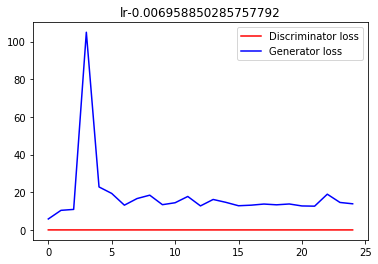

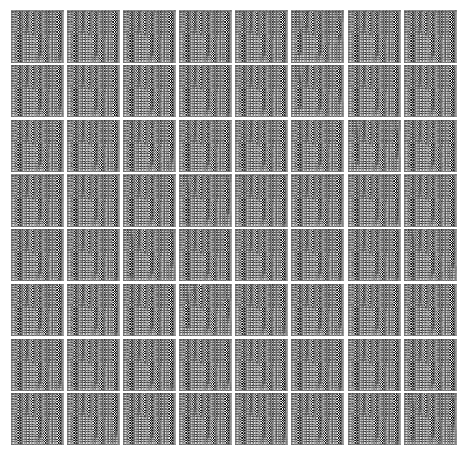

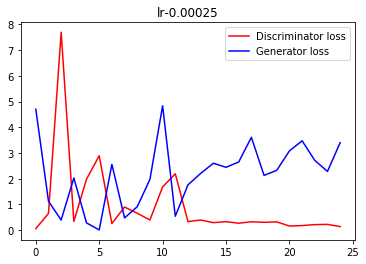

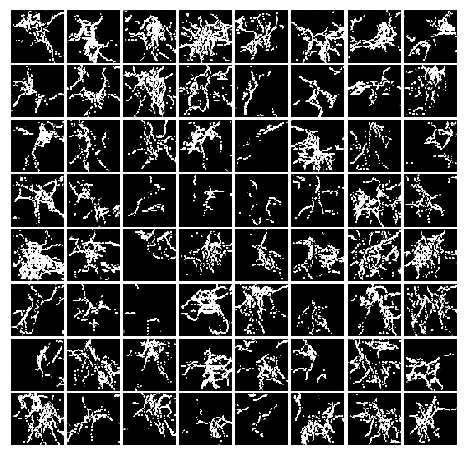

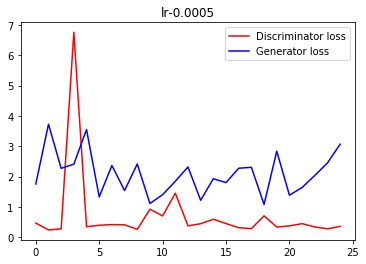

...

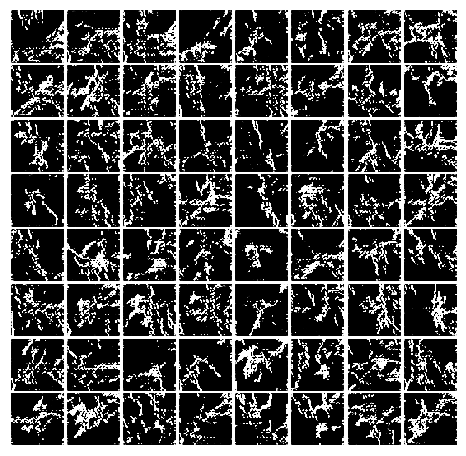

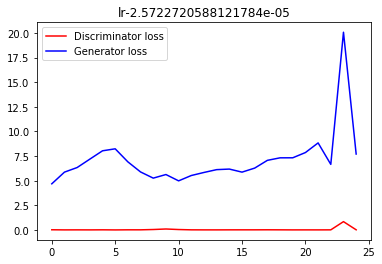

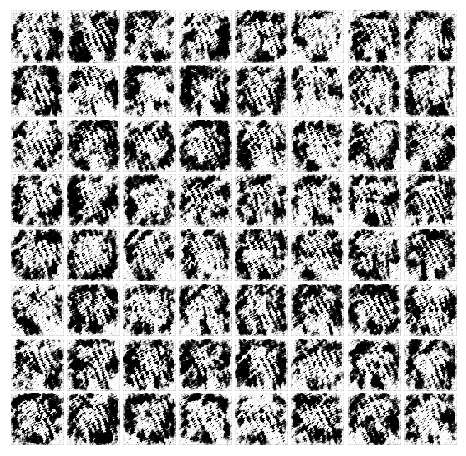

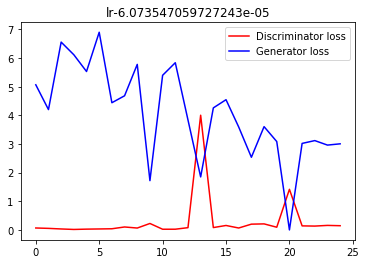

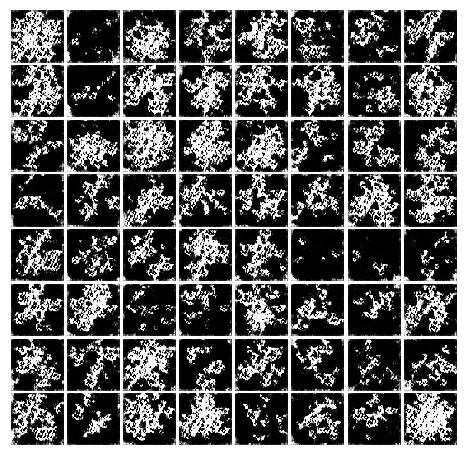

In [14]:
# Show DCGAN loss curves and sample generated images
for lr in results_dg.keys():
    title = 'lr-' + str(lr)
    d_loss_list, g_loss_list, fake_imgs, _, G = results_dg[lr]
    plot_loss(d_loss_list, g_loss_list, title=title)
    test_imgs = gan_generate(dtype, G)
    show_images(test_imgs)


Having identified the ideal learning rate, I will train a DCGAN for 100 epochs, and save the model


0.0006852589613748453
lr-0.0006852589613748453-ls-0-in-0
Iter: 0, D: 1.348, G:1.114


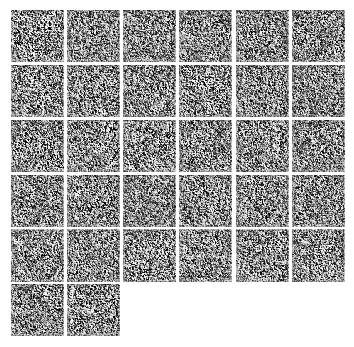


Iter: 100, D: 0.9094, G:0.7321


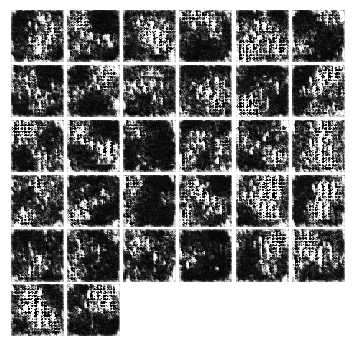


Iter: 200, D: 0.8564, G:1.007


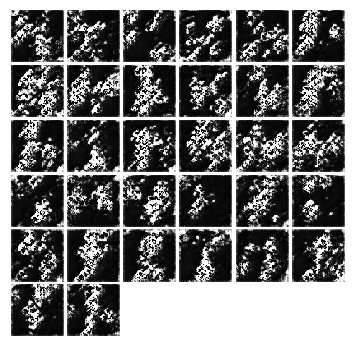


Iter: 300, D: 1.388, G:0.7085


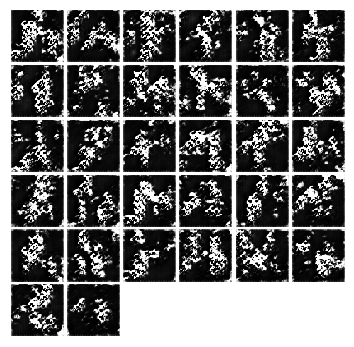


Iter: 400, D: 1.217, G:1.337


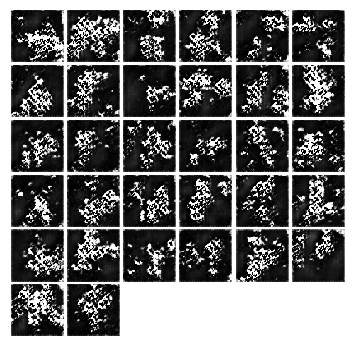


Iter: 500, D: 0.9432, G:0.9909


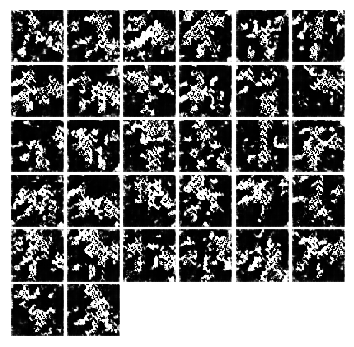


Iter: 600, D: 1.304, G:0.7916


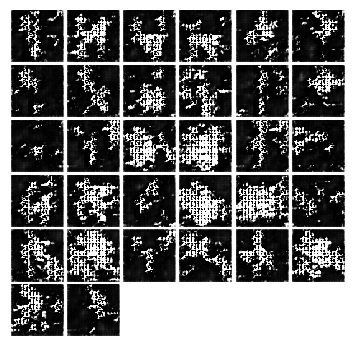


Iter: 700, D: 1.288, G:0.9362


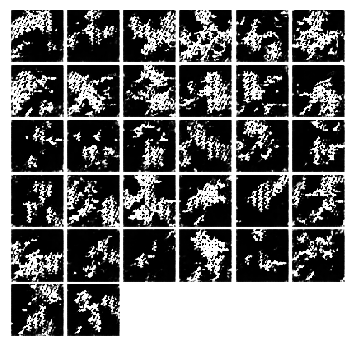


Iter: 800, D: 1.332, G:0.7254


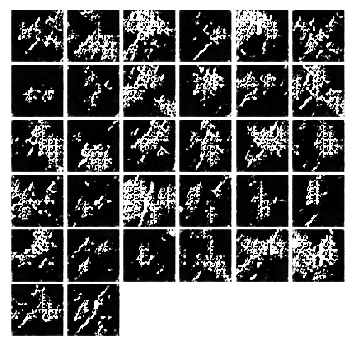


Iter: 900, D: 1.156, G:0.7879


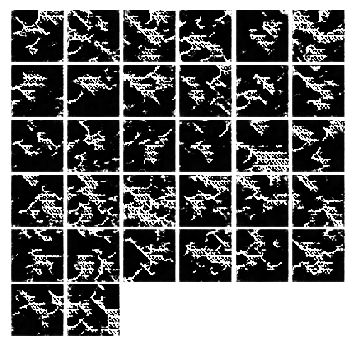


Iter: 1000, D: 1.122, G:1.323


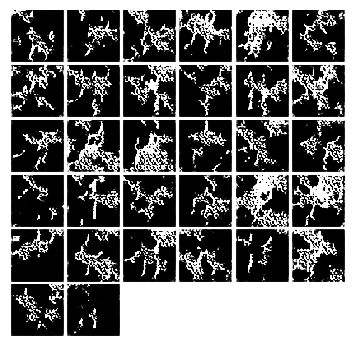


Iter: 1100, D: 1.266, G:0.8774


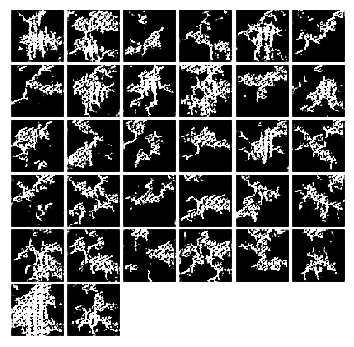


Iter: 1200, D: 1.029, G:0.6428


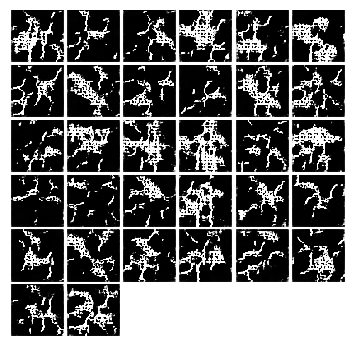


Iter: 1300, D: 1.799, G:3.959


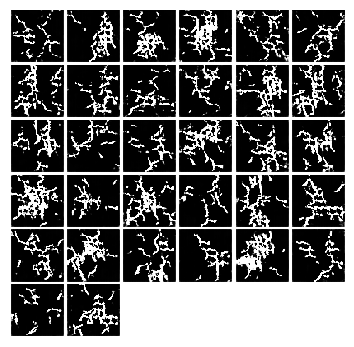


Iter: 1400, D: 0.9702, G:1.36


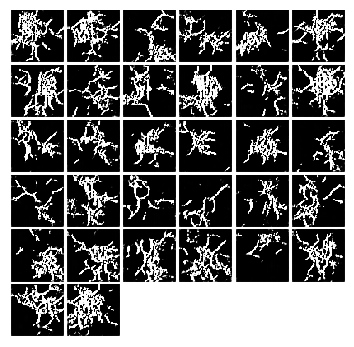


Iter: 1500, D: 0.7922, G:1.225


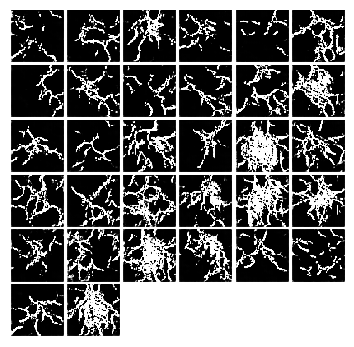


Iter: 1600, D: 0.7644, G:1.178


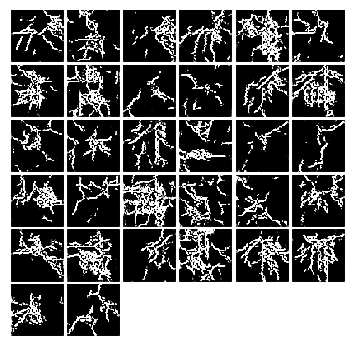


Iter: 1700, D: 0.6538, G:1.097


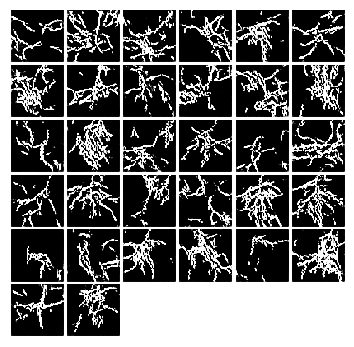


Iter: 1800, D: 0.7903, G:1.836


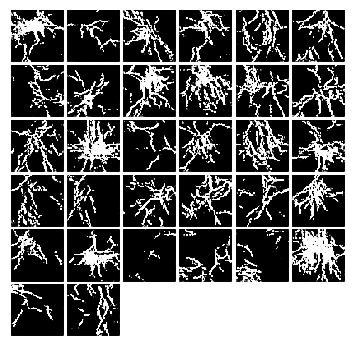


Iter: 1900, D: 0.7123, G:1.535


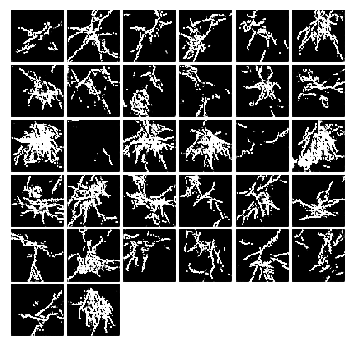


Iter: 2000, D: 0.4294, G:2.925


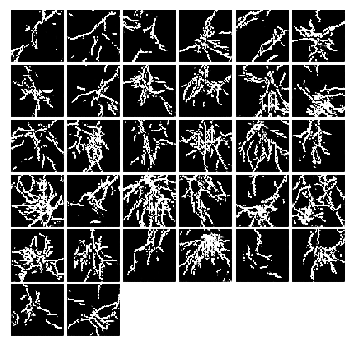


Iter: 2100, D: 0.4073, G:2.46


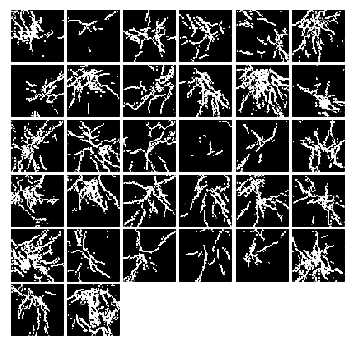


Iter: 2200, D: 0.685, G:4.183


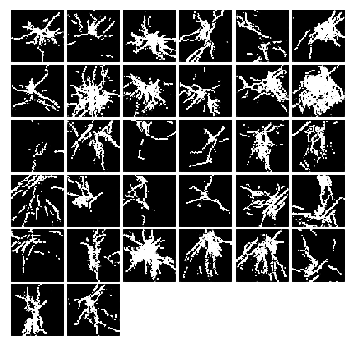


Iter: 2300, D: 0.4288, G:4.201


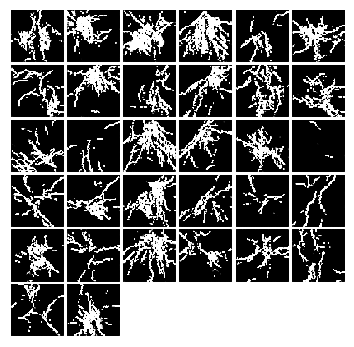


Iter: 2400, D: 0.7651, G:1.789


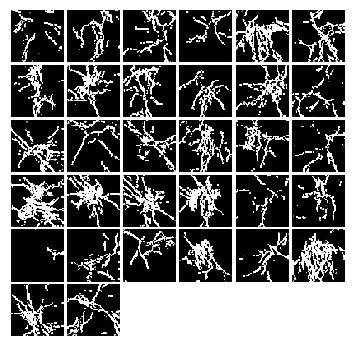


Iter: 2500, D: 0.4312, G:3.048


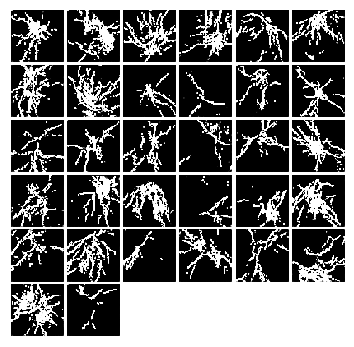


Iter: 2600, D: 0.2439, G:3.375


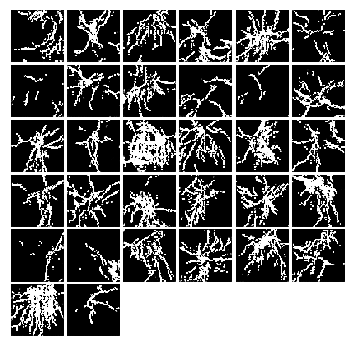


Iter: 2700, D: 0.1858, G:2.921


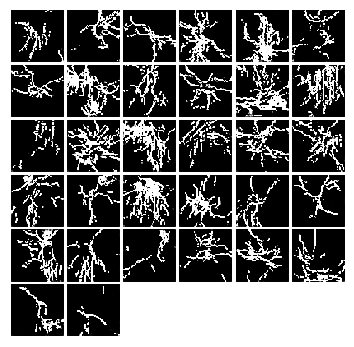


Iter: 2800, D: 0.5194, G:2.376


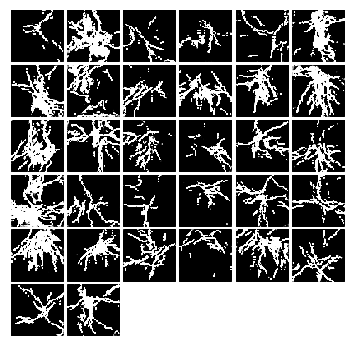


Iter: 2900, D: 0.2869, G:3.544


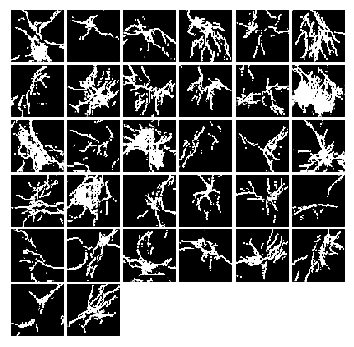


Iter: 3000, D: 0.169, G:3.476


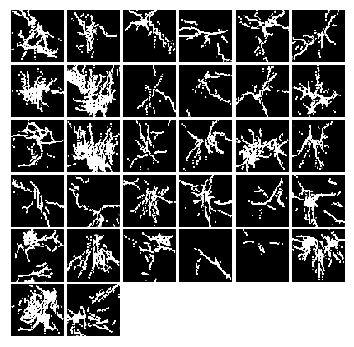


Iter: 3100, D: 0.3982, G:1.652


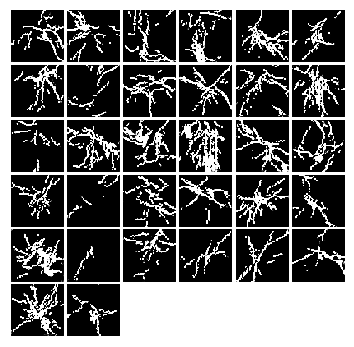


Iter: 3200, D: 0.7403, G:1.294


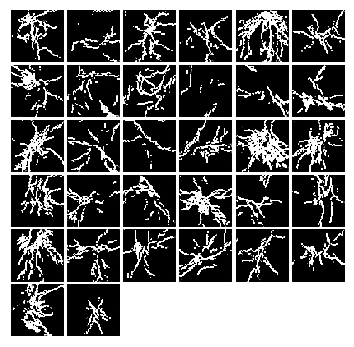


Iter: 3300, D: 0.3232, G:3.47


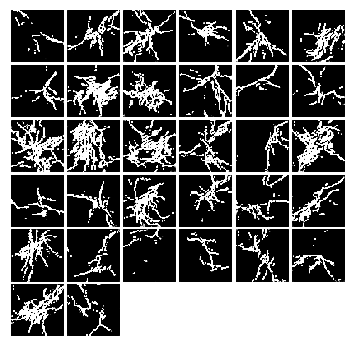


Iter: 3400, D: 0.2386, G:3.941


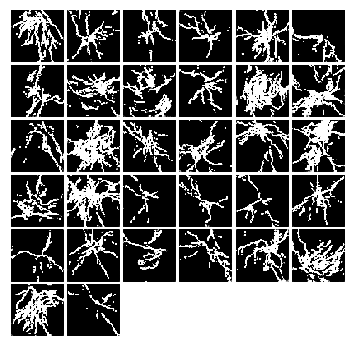


Iter: 3500, D: 0.1233, G:3.572


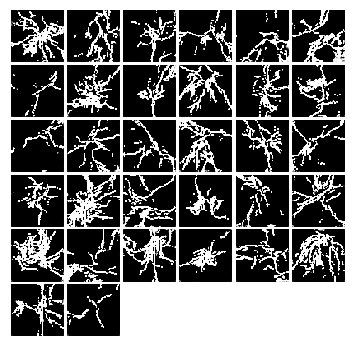


Iter: 3600, D: 0.04296, G:4.689


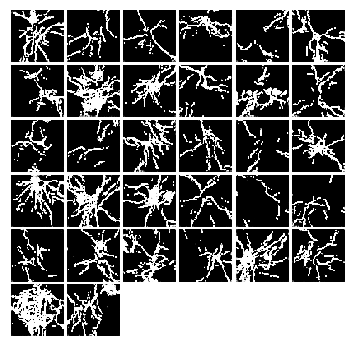


Iter: 3700, D: 0.2128, G:4.309


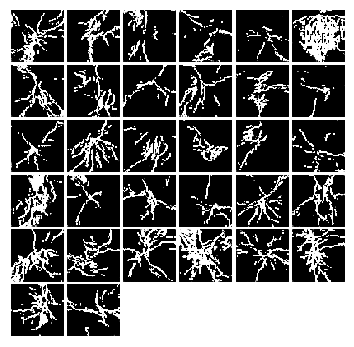


Iter: 3800, D: 0.1484, G:3.546


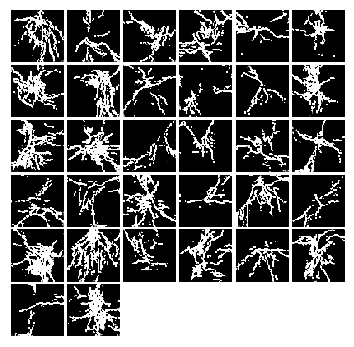


Iter: 3900, D: 0.03898, G:5.794


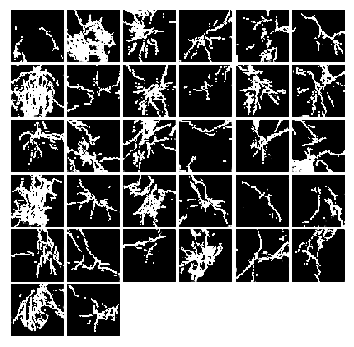


Iter: 4000, D: 0.837, G:1.095


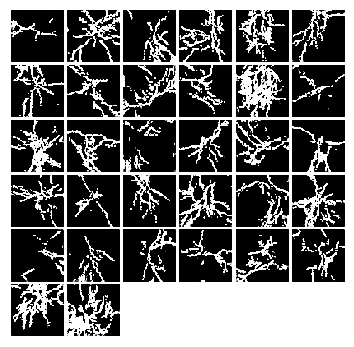


Iter: 4100, D: 0.5512, G:2.304


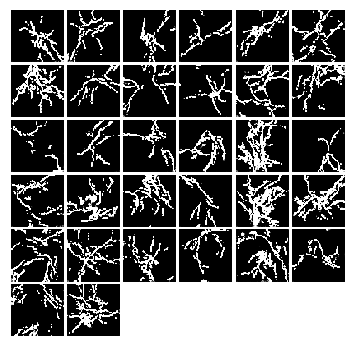


Iter: 4200, D: 0.4957, G:2.591


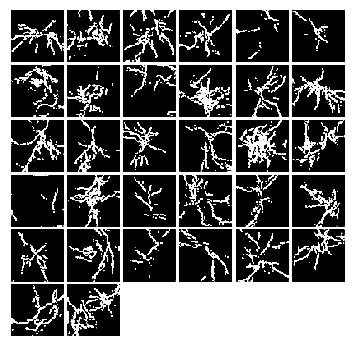


Iter: 4300, D: 0.4169, G:4.097


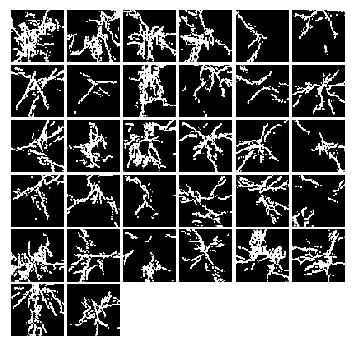


Iter: 4400, D: 0.2841, G:4.314


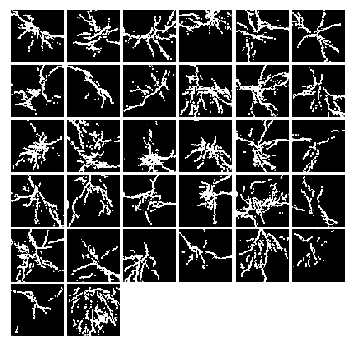


Iter: 4500, D: 0.2648, G:3.861


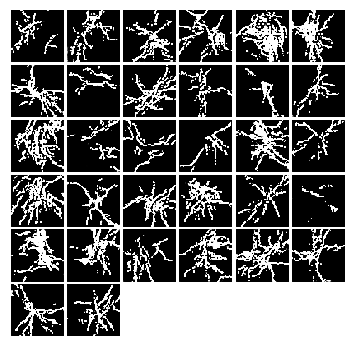


Iter: 4600, D: 0.1645, G:5.74


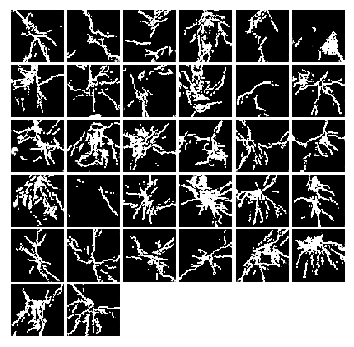


Iter: 4700, D: 0.1802, G:4.745


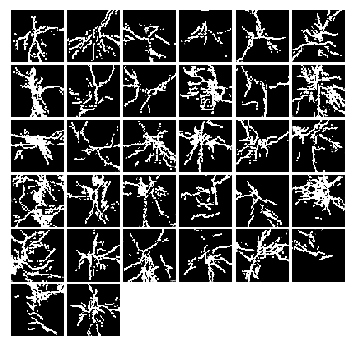


Iter: 4800, D: 0.1877, G:5.093


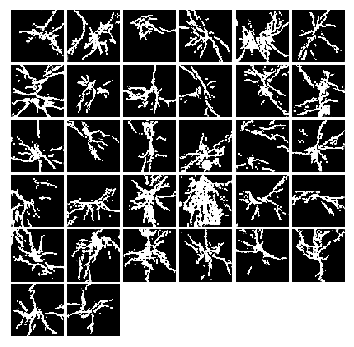


Iter: 4900, D: 0.09834, G:6.051


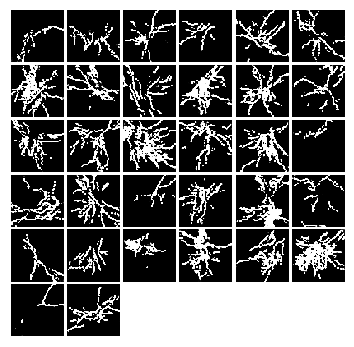


Iter: 5000, D: 0.2285, G:3.055


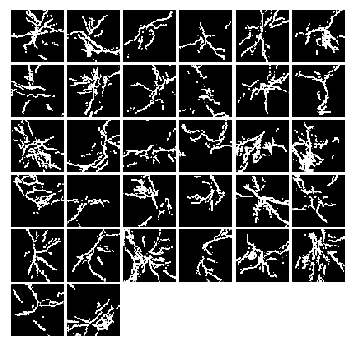


Iter: 5100, D: 0.2078, G:5.192


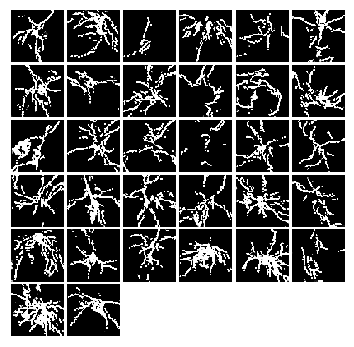


Iter: 5200, D: 0.1456, G:5.787


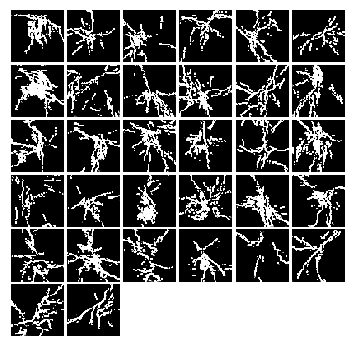


Iter: 5300, D: 0.1024, G:5.116


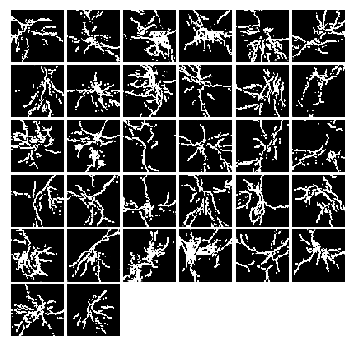


Iter: 5400, D: 0.228, G:5.475


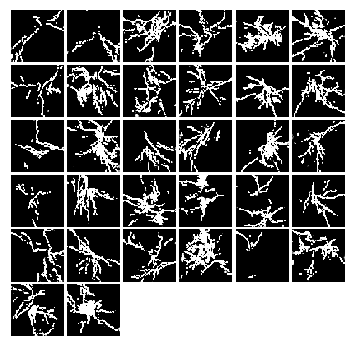


Iter: 5500, D: 0.1598, G:4.815


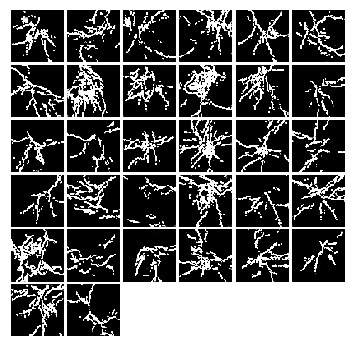


Iter: 5600, D: 0.1069, G:5.416


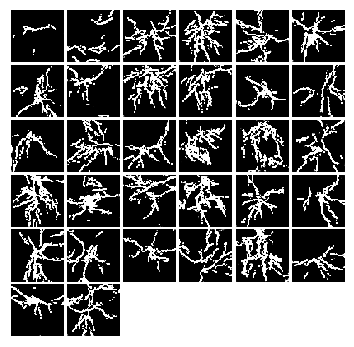


Iter: 5700, D: 0.1159, G:7.472


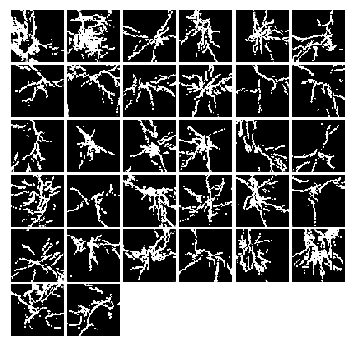


Iter: 5800, D: 0.04746, G:7.331


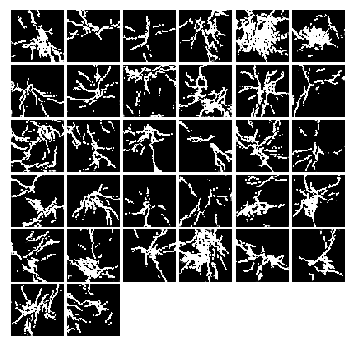


Iter: 5900, D: 0.08781, G:5.534


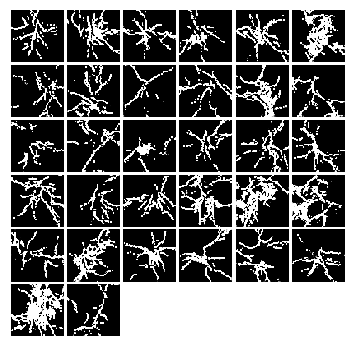


Iter: 6000, D: 0.08467, G:7.202


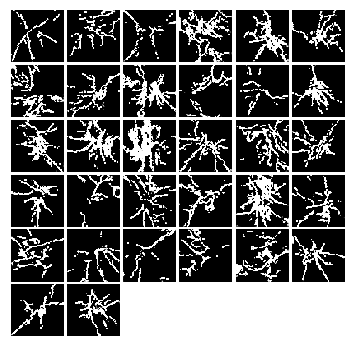


Iter: 6100, D: 0.1313, G:6.611


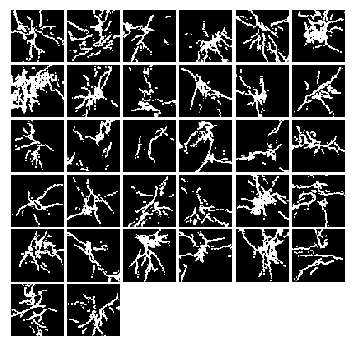


Iter: 6200, D: 0.8424, G:1.395


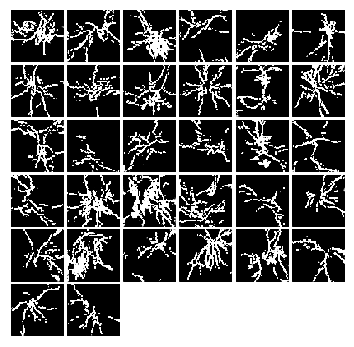


Iter: 6300, D: 0.2477, G:3.564


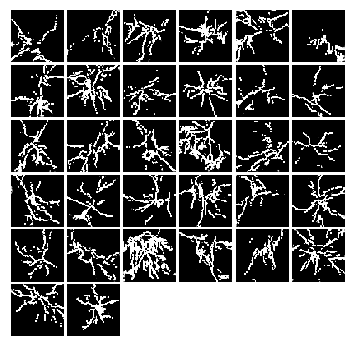


Iter: 6400, D: 0.1374, G:6.09


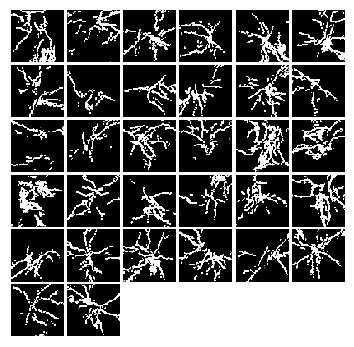


Iter: 6500, D: 0.07902, G:6.498


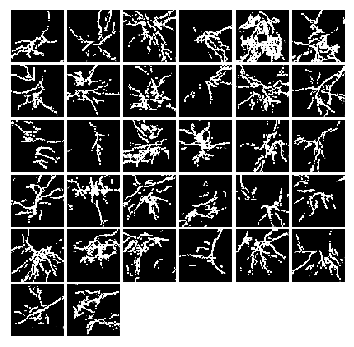


Iter: 6600, D: 0.1436, G:7.716


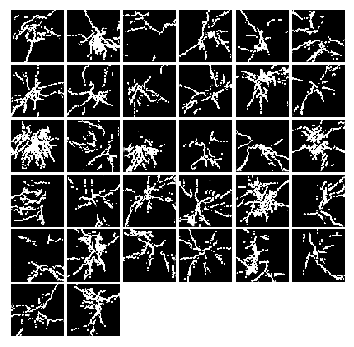


Iter: 6700, D: 0.1123, G:6.547


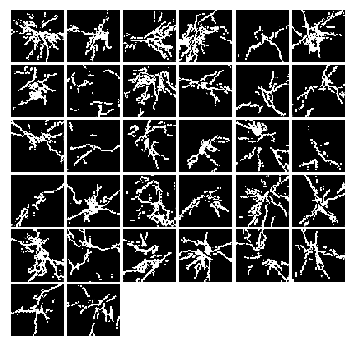


Iter: 6800, D: 0.09183, G:6.94


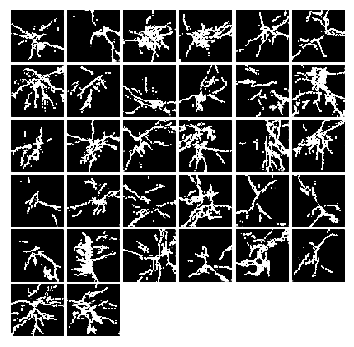


Iter: 6900, D: 0.07665, G:7.977


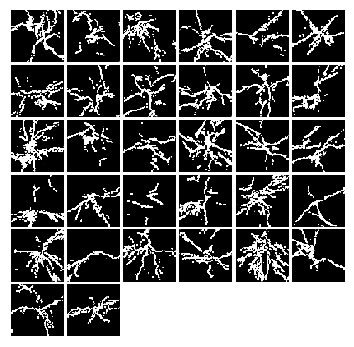


Iter: 7000, D: 0.09138, G:7.183


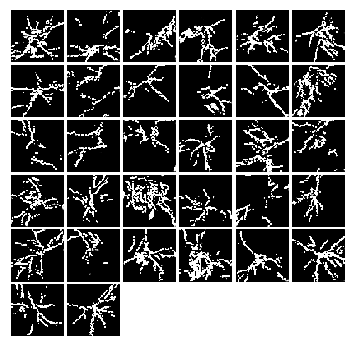


Iter: 7100, D: 0.02623, G:8.319


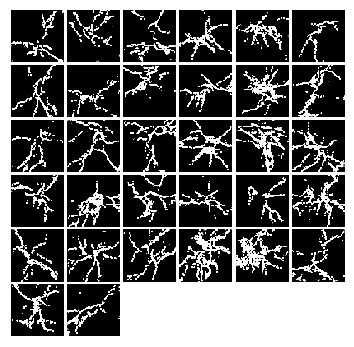


Iter: 7200, D: 0.02575, G:8.505


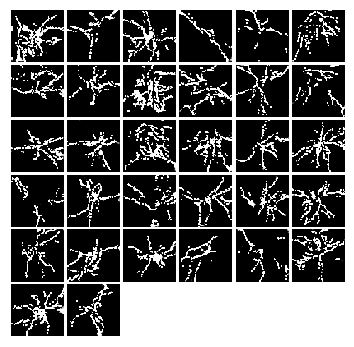


Iter: 7300, D: 0.01456, G:7.796


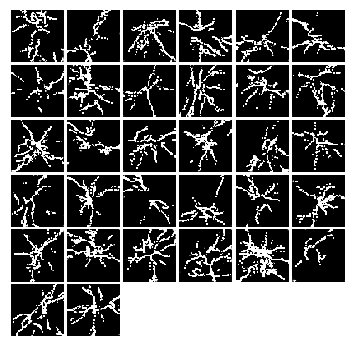


Iter: 7400, D: 0.001085, G:8.854


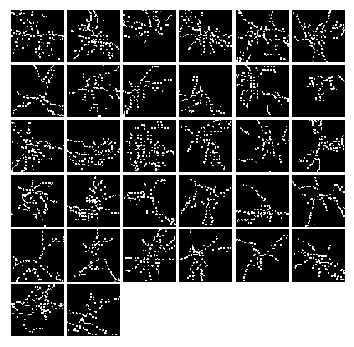


Iter: 7500, D: 0.004459, G:9.448


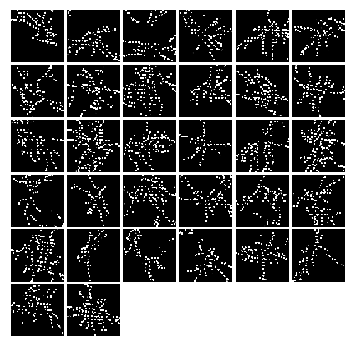


Iter: 7600, D: 0.0003503, G:10.27


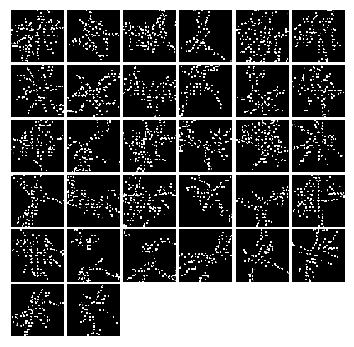


Iter: 7700, D: 0.001083, G:10.66


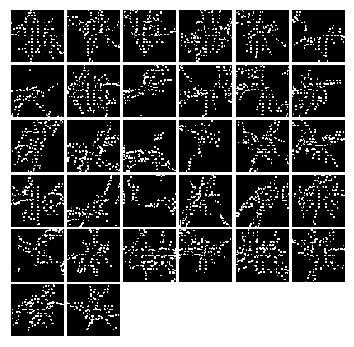


lr-0.0006852589613748453-ls-0-in-1
Iter: 0, D: 1.403, G:1.283


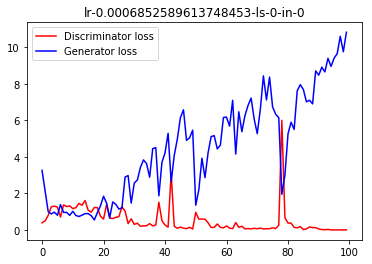

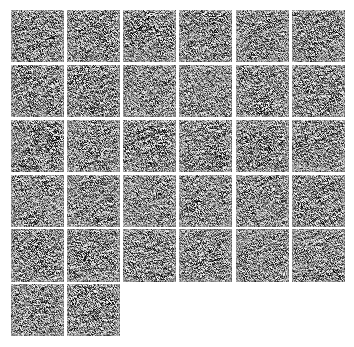


Iter: 100, D: 1.434, G:1.459


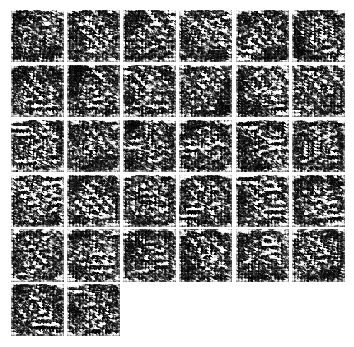


Iter: 200, D: 1.221, G:0.6844


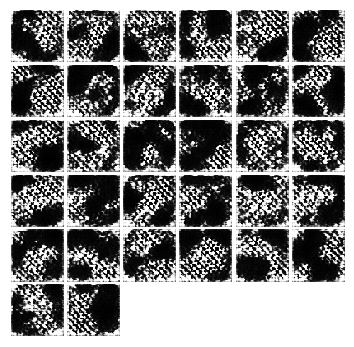


Iter: 300, D: 0.847, G:0.9842


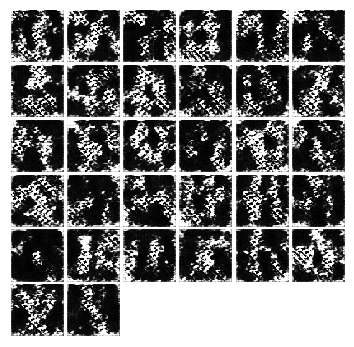


Iter: 400, D: 0.944, G:0.9538


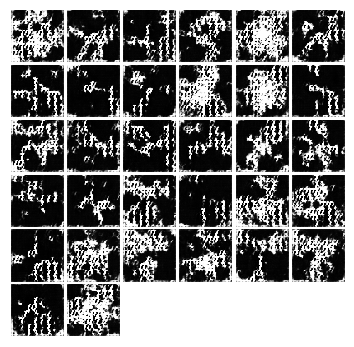


Iter: 500, D: 0.669, G:0.79


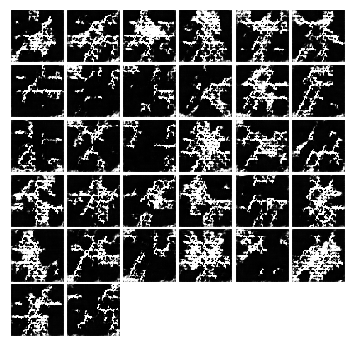


Iter: 600, D: 1.099, G:0.1938


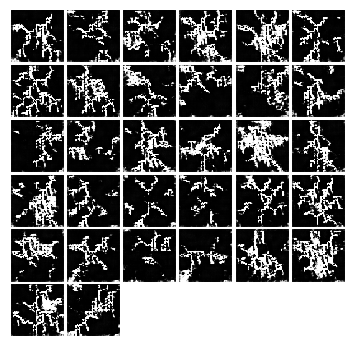


Iter: 700, D: 1.027, G:0.8044


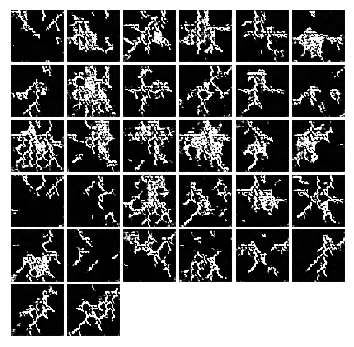


Iter: 800, D: 0.7582, G:1.711


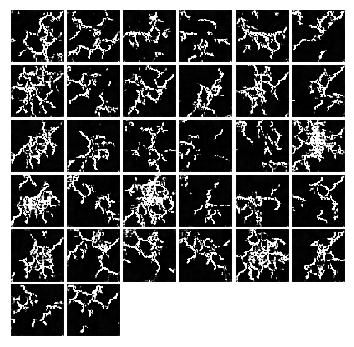


Iter: 900, D: 1.261, G:0.8127


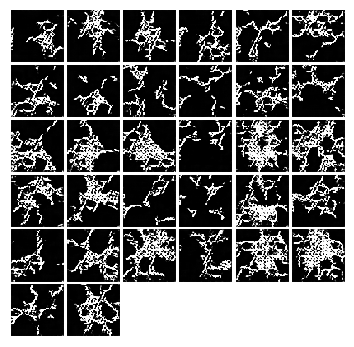


Iter: 1000, D: 1.252, G:1.128


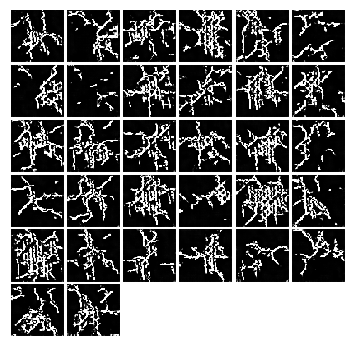


Iter: 1100, D: 1.024, G:0.9944


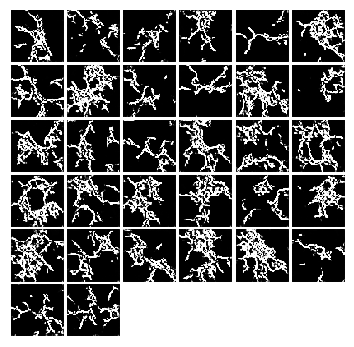


Iter: 1200, D: 0.84, G:1.984


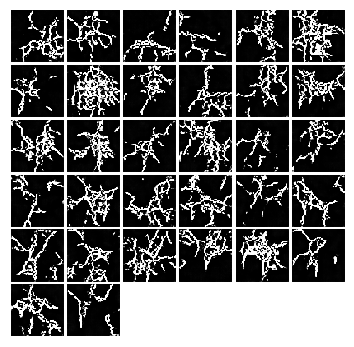


Iter: 1300, D: 0.6951, G:1.274


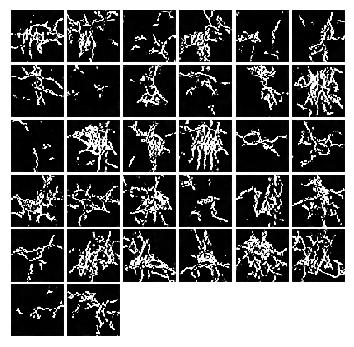


Iter: 1400, D: 1.383, G:0.8758


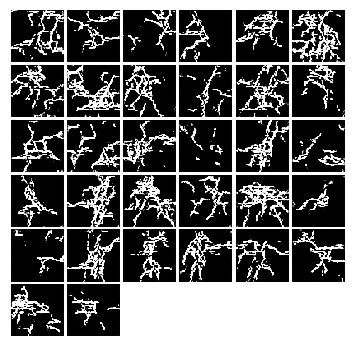


Iter: 1500, D: 1.302, G:0.7687


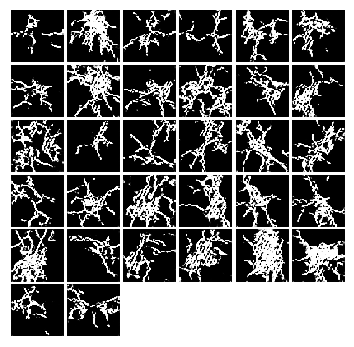


Iter: 1600, D: 1.328, G:0.851


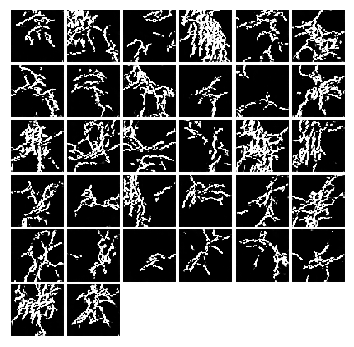


Iter: 1700, D: 0.8511, G:0.9461


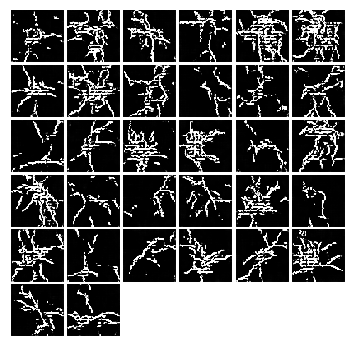


Iter: 1800, D: 0.6435, G:1.719


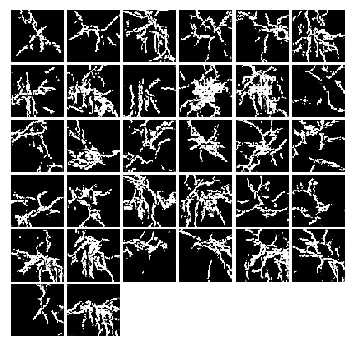


Iter: 1900, D: 0.4967, G:1.685


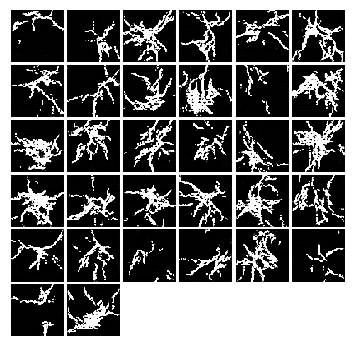


Iter: 2000, D: 0.394, G:2.367


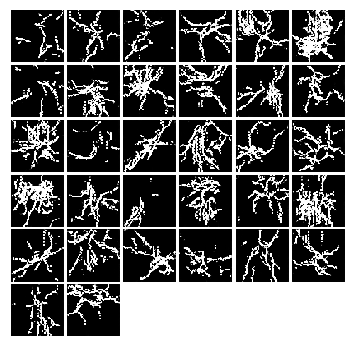


Iter: 2100, D: 0.3082, G:2.465


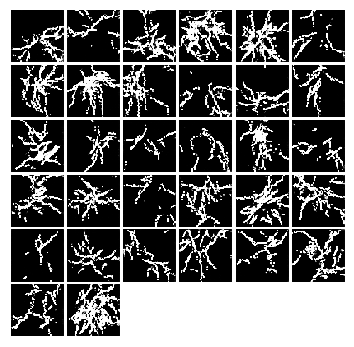


Iter: 2200, D: 0.5515, G:1.819


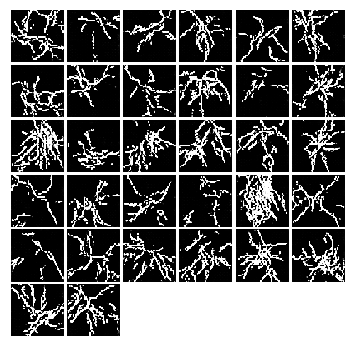


Iter: 2300, D: 0.3955, G:1.556


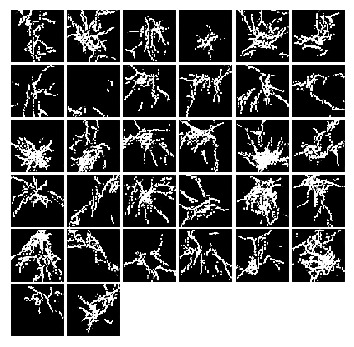


Iter: 2400, D: 0.8228, G:1.236


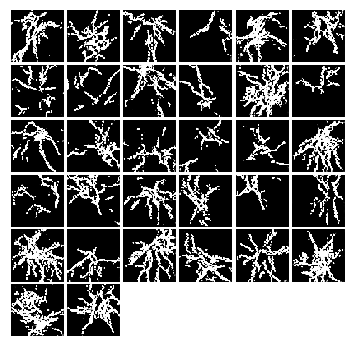


Iter: 2500, D: 0.3503, G:2.741


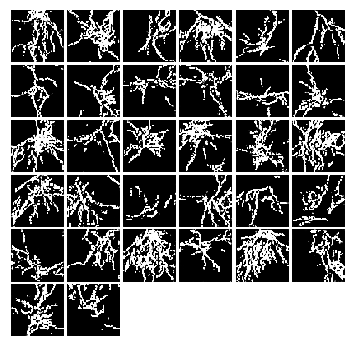


Iter: 2600, D: 0.3156, G:2.703


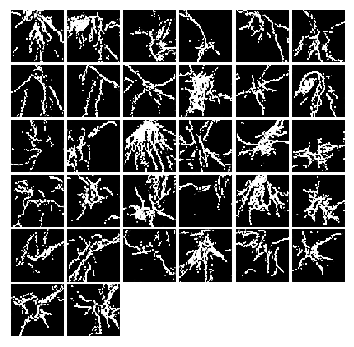


Iter: 2700, D: 0.6525, G:1.443


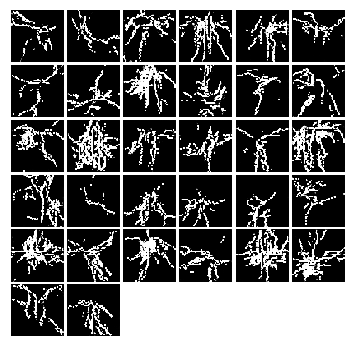


Iter: 2800, D: 0.1203, G:3.255


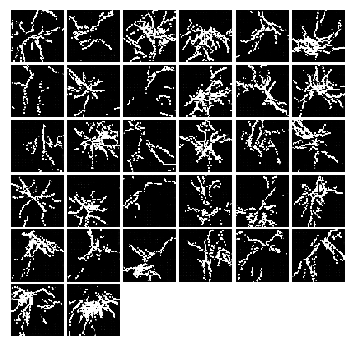


Iter: 2900, D: 0.304, G:3.06


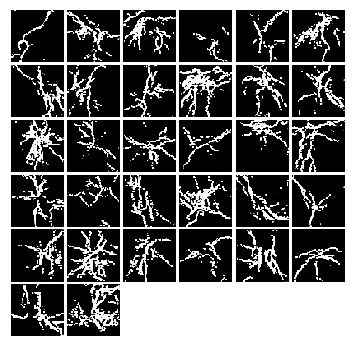


Iter: 3000, D: 0.08318, G:5.572


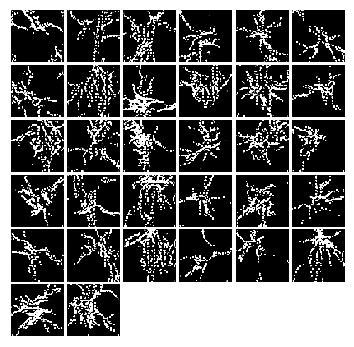


Iter: 3100, D: 0.03816, G:5.409


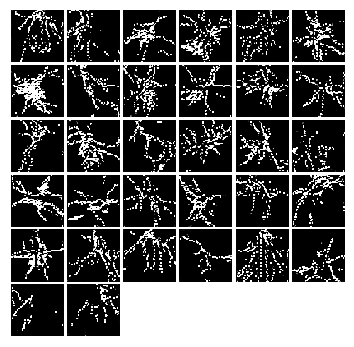


Iter: 3200, D: 0.03535, G:5.308


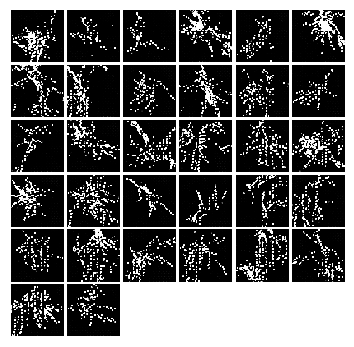


Iter: 3300, D: 7.877, G:3.058


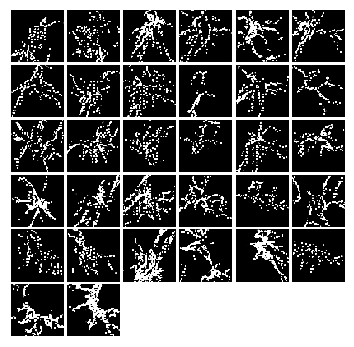


Iter: 3400, D: 0.3433, G:2.929


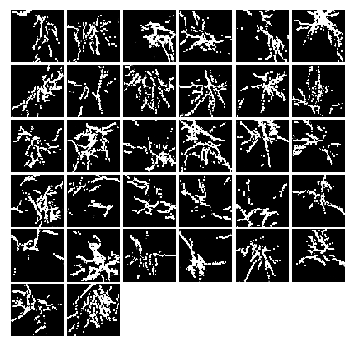


Iter: 3500, D: 1.048, G:1.051


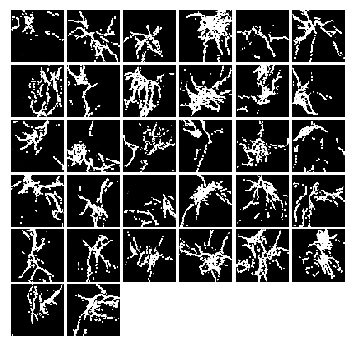


Iter: 3600, D: 1.198, G:0.5947


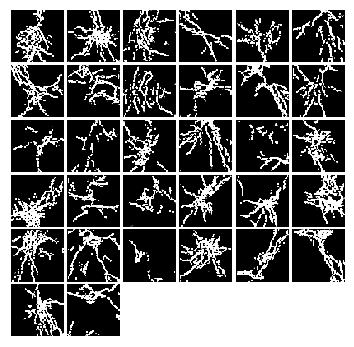


Iter: 3700, D: 0.5734, G:2.426


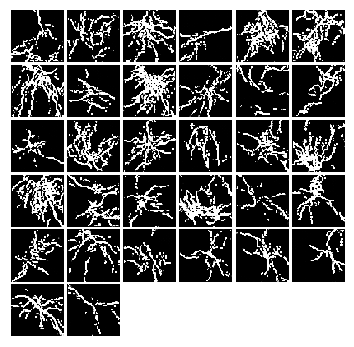


Iter: 3800, D: 0.4135, G:2.544


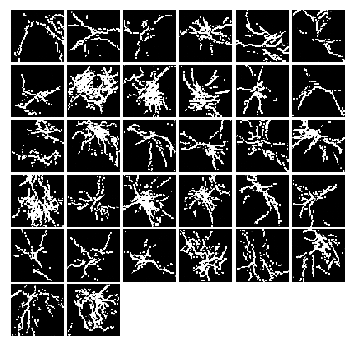


Iter: 3900, D: 0.2699, G:3.693


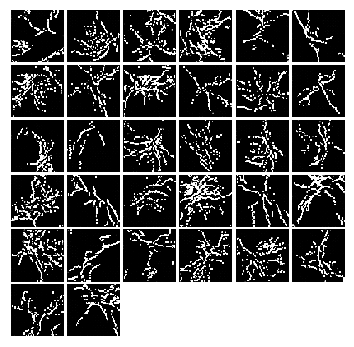


Iter: 4000, D: 0.1647, G:5.101


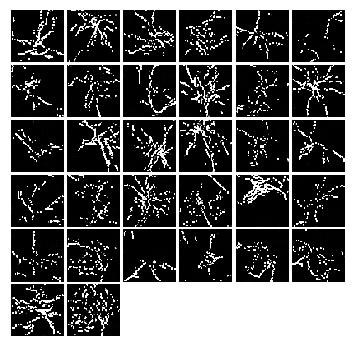


Iter: 4100, D: 0.4789, G:3.532


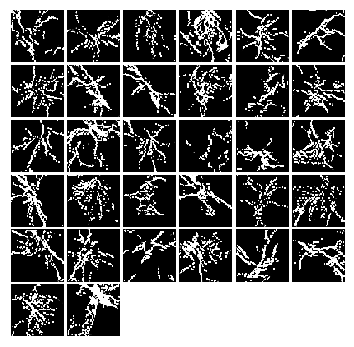


Iter: 4200, D: 0.4149, G:2.235


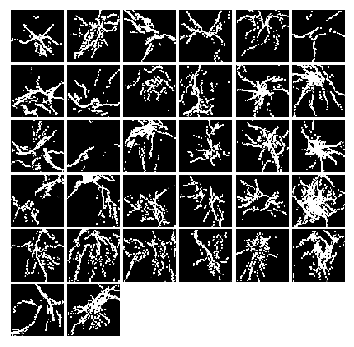


Iter: 4300, D: 0.2064, G:4.994


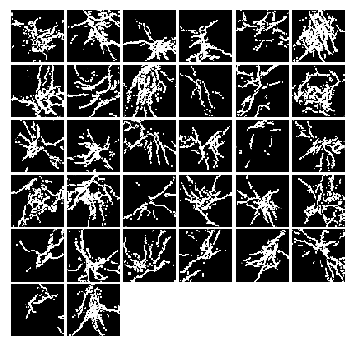


Iter: 4400, D: 0.1567, G:4.762


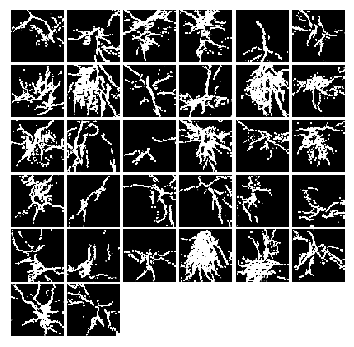


Iter: 4500, D: 0.3549, G:3.913


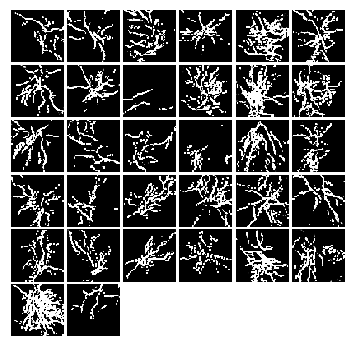


Iter: 4600, D: 0.3452, G:4.25


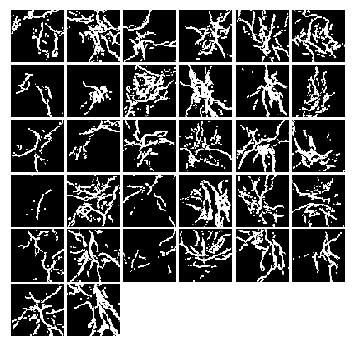


Iter: 4700, D: 0.06935, G:5.41


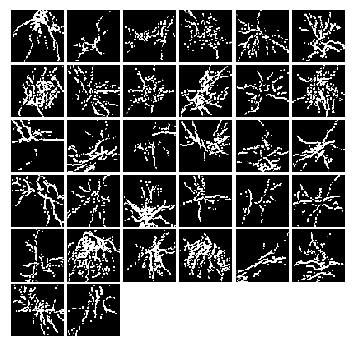


Iter: 4800, D: 0.04859, G:6.569


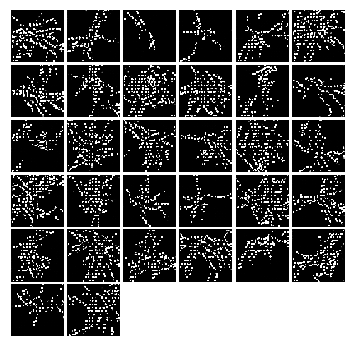


Iter: 4900, D: 0.01974, G:7.713


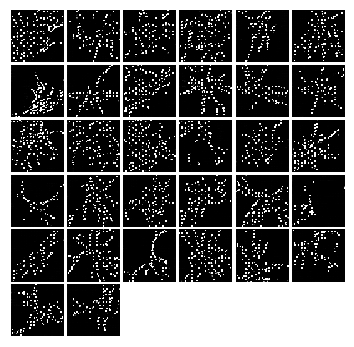


Iter: 5000, D: 0.01363, G:8.461


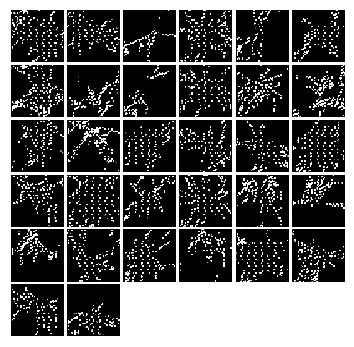


Iter: 5100, D: 0.02602, G:7.511


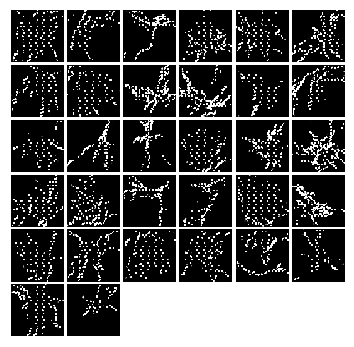


Iter: 5200, D: 0.05504, G:4.986


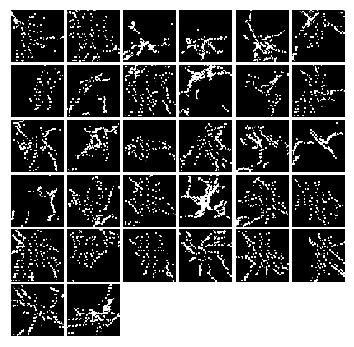


Iter: 5300, D: 0.05087, G:7.794


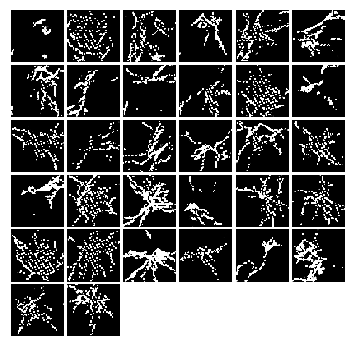


Iter: 5400, D: 0.08065, G:6.935


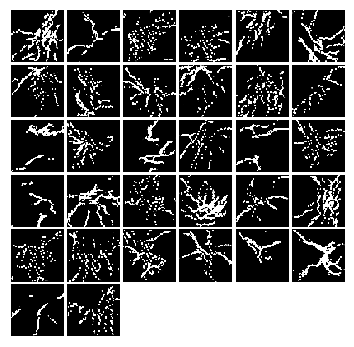


Iter: 5500, D: 0.1056, G:6.551


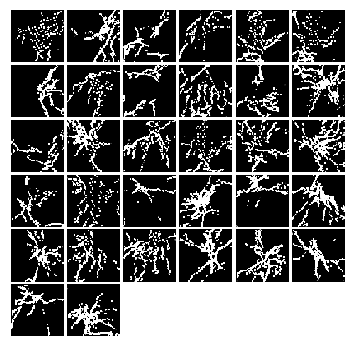


Iter: 5600, D: 0.1072, G:5.669


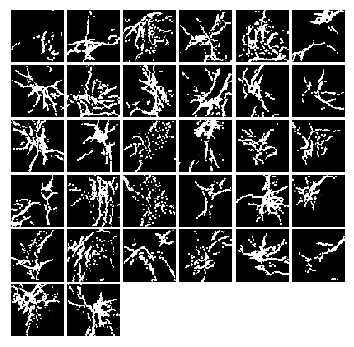


Iter: 5700, D: 0.133, G:6.76


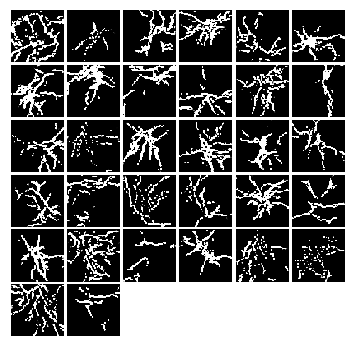


Iter: 5800, D: 0.0523, G:6.548


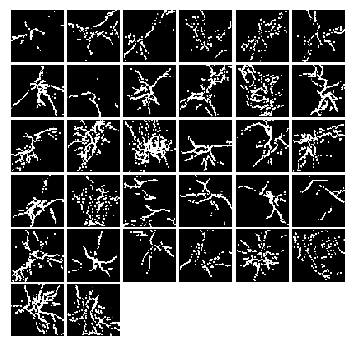


Iter: 5900, D: 1.007, G:1.369


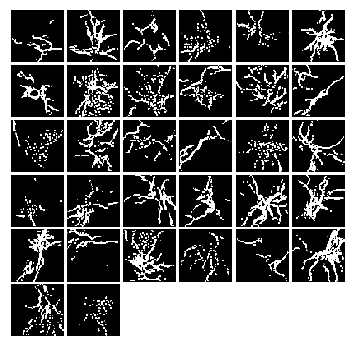


Iter: 6000, D: 0.6686, G:1.545


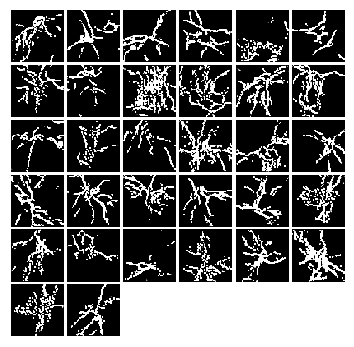


Iter: 6100, D: 0.3509, G:3.222


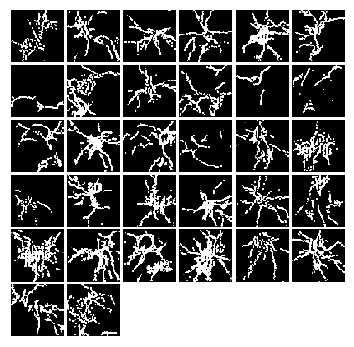


Iter: 6200, D: 0.1371, G:5.035


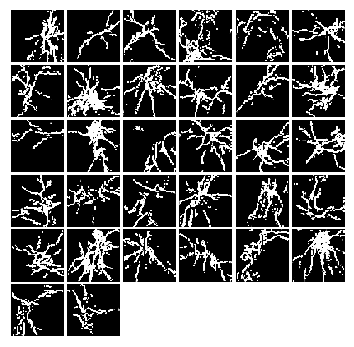


Iter: 6300, D: 0.2201, G:3.625


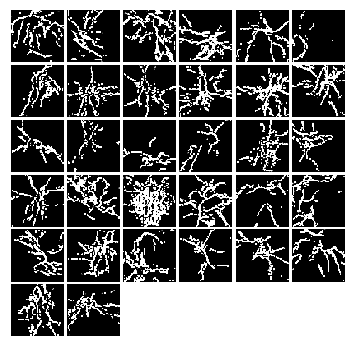


Iter: 6400, D: 0.08569, G:5.751


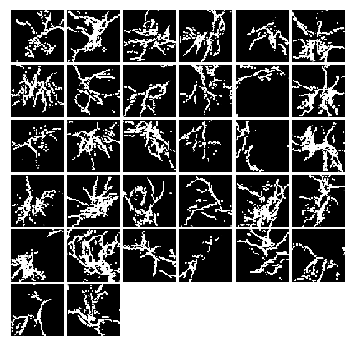


Iter: 6500, D: 0.1133, G:6.667


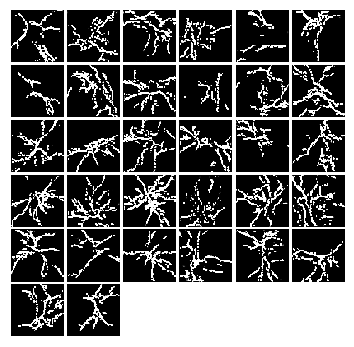


Iter: 6600, D: 0.1859, G:4.664


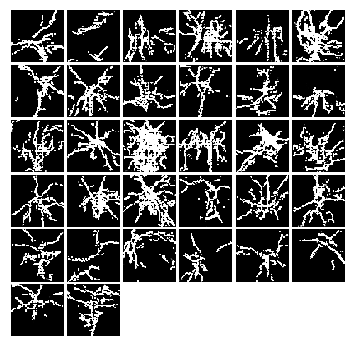


Iter: 6700, D: 0.07541, G:6.109


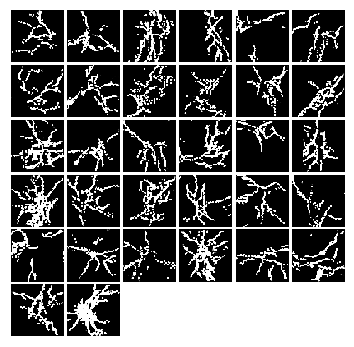


Iter: 6800, D: 0.07094, G:5.455


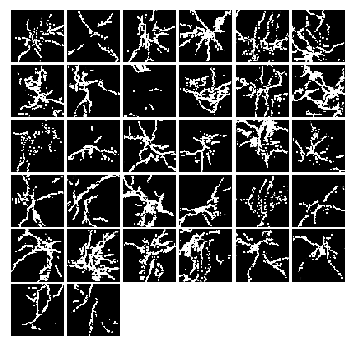


Iter: 6900, D: 0.09018, G:7.152


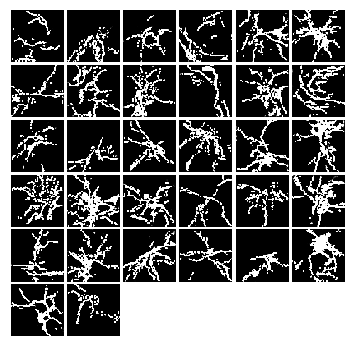


Iter: 7000, D: 0.04978, G:5.764


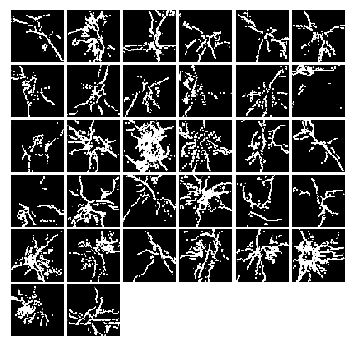


Iter: 7100, D: 0.219, G:6.186


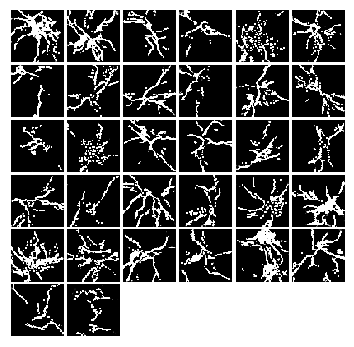


Iter: 7200, D: 0.1281, G:8.407


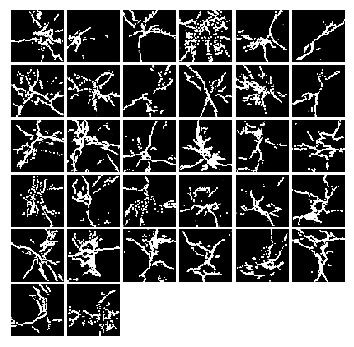


Iter: 7300, D: 0.2212, G:6.258


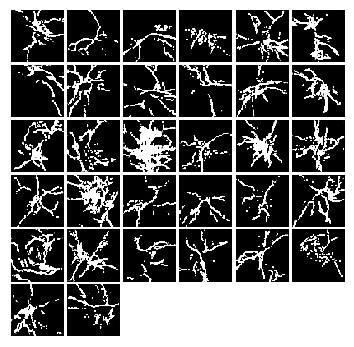


Iter: 7400, D: 0.2088, G:4.921


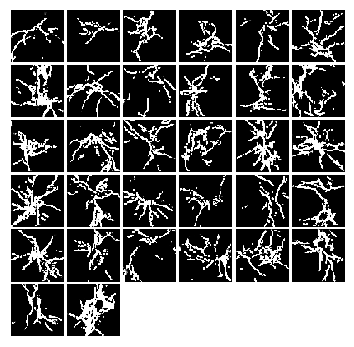


Iter: 7500, D: 0.07581, G:7.291


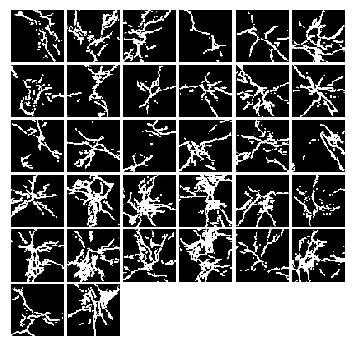


Iter: 7600, D: 0.05342, G:7.365


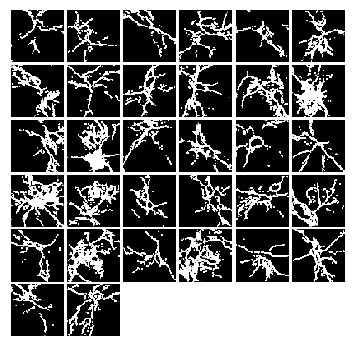


Iter: 7700, D: 0.294, G:4.352


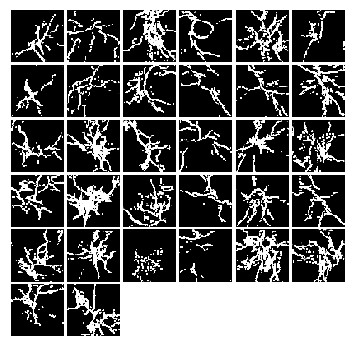


lr-0.0006852589613748453-ls-1-in-0
Iter: 0, D: 1.393, G:0.1931


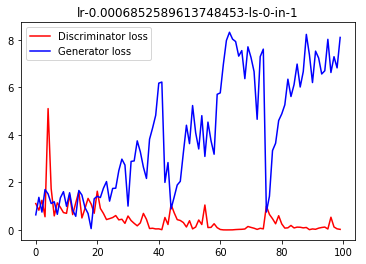

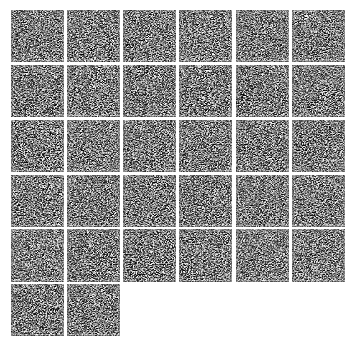


Iter: 100, D: 0.9153, G:1.029


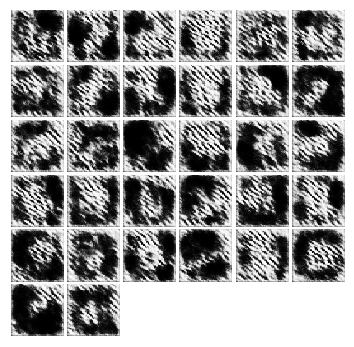


Iter: 200, D: 3.828, G:0.3447


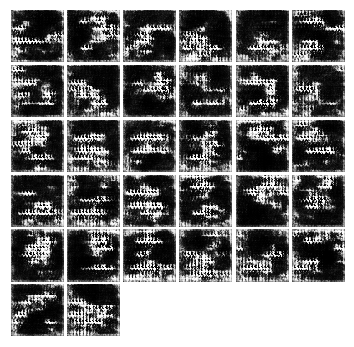


Iter: 300, D: 0.7619, G:1.209


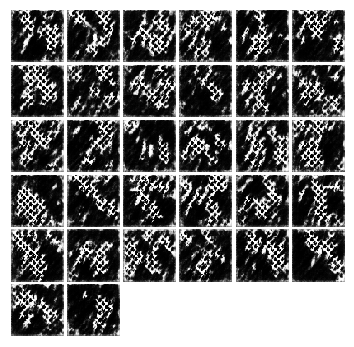


Iter: 400, D: 0.908, G:1.694


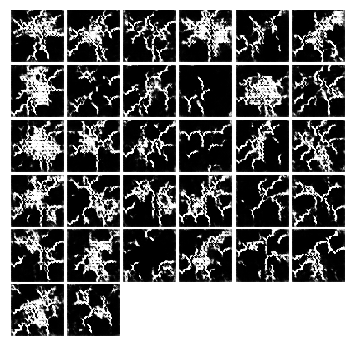


Iter: 500, D: 1.207, G:1.403


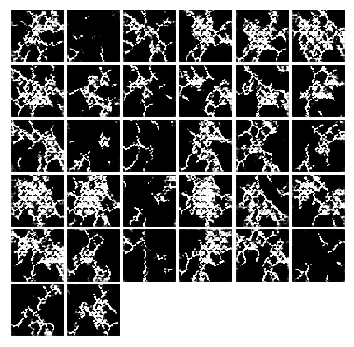


Iter: 600, D: 1.16, G:0.9216


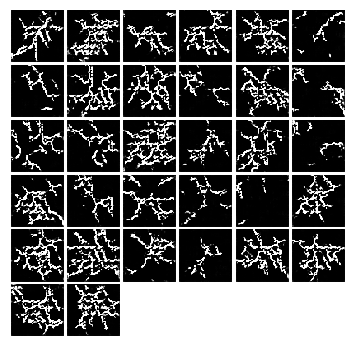


Iter: 700, D: 1.773, G:1.264


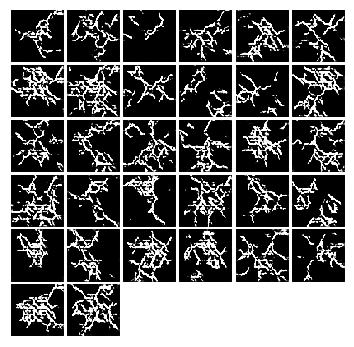


Iter: 800, D: 1.107, G:1.127


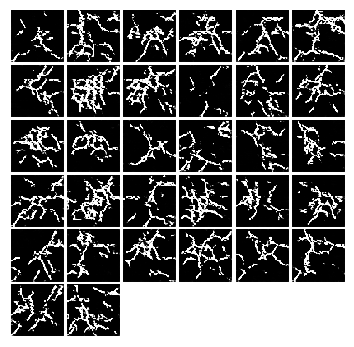


Iter: 900, D: 1.041, G:1.122


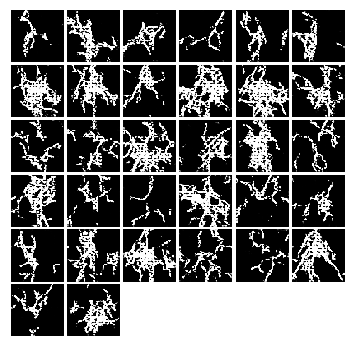


Iter: 1000, D: 1.073, G:1.146


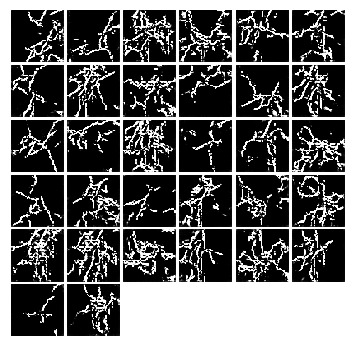


Iter: 1100, D: 0.9331, G:1.245


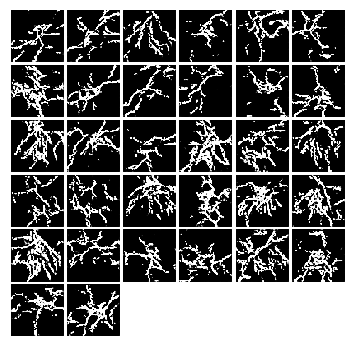


Iter: 1200, D: 1.137, G:0.8198


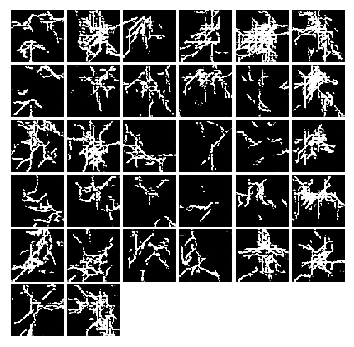


Iter: 1300, D: 1.259, G:0.2731


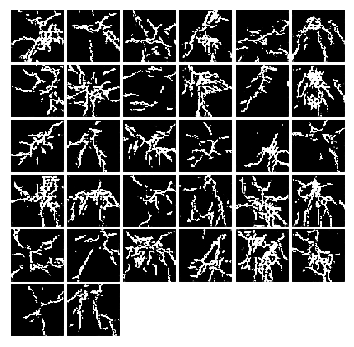


Iter: 1400, D: 0.6382, G:2.292


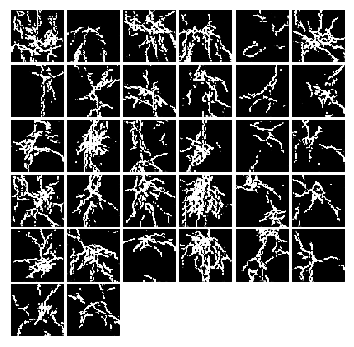


Iter: 1500, D: 0.9193, G:1.226


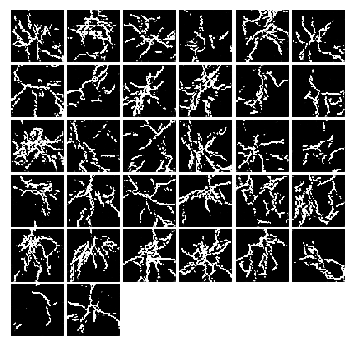


Iter: 1600, D: 0.8246, G:1.066


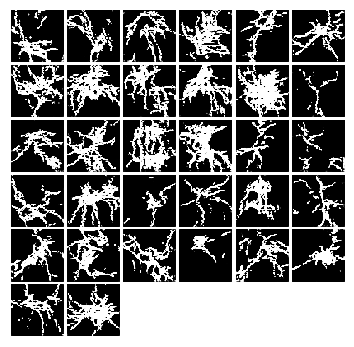


Iter: 1700, D: 3.186, G:0.8545


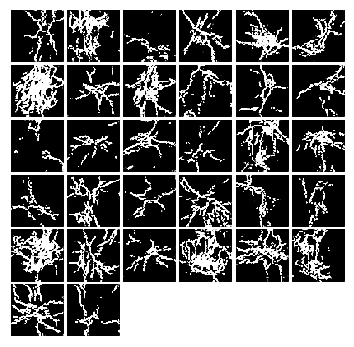


Iter: 1800, D: 0.641, G:1.701


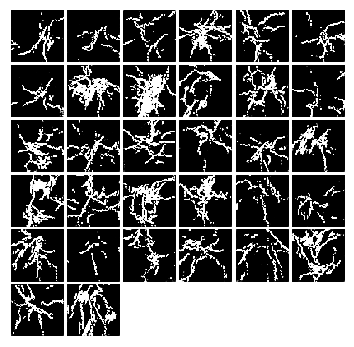


Iter: 1900, D: 0.4559, G:1.921


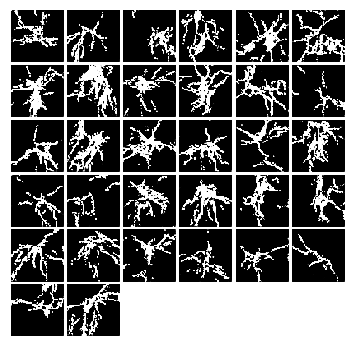


Iter: 2000, D: 0.6373, G:1.5


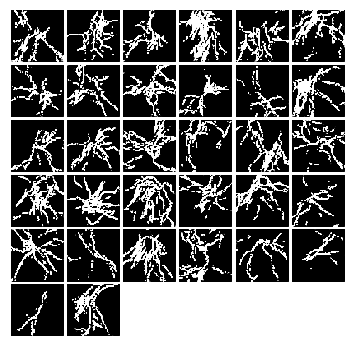


Iter: 2100, D: 3.693, G:0.9184


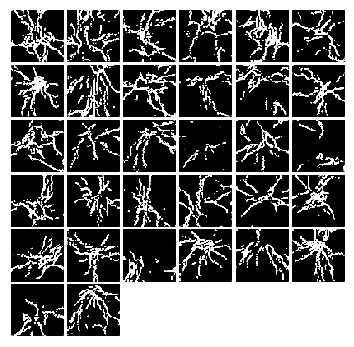


Iter: 2200, D: 0.5816, G:2.096


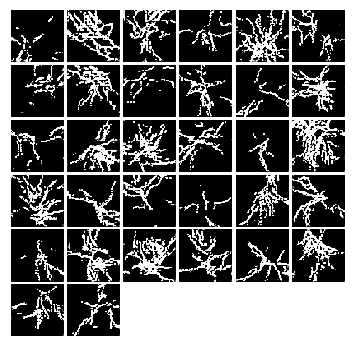


Iter: 2300, D: 0.6257, G:1.639


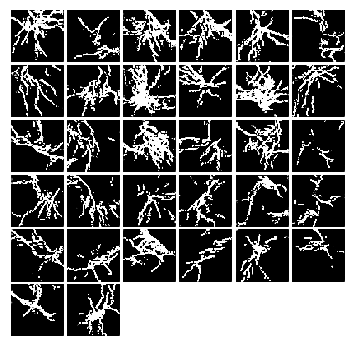


Iter: 2400, D: 0.5696, G:2.542


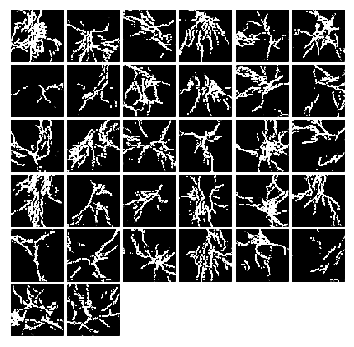


Iter: 2500, D: 0.3447, G:2.608


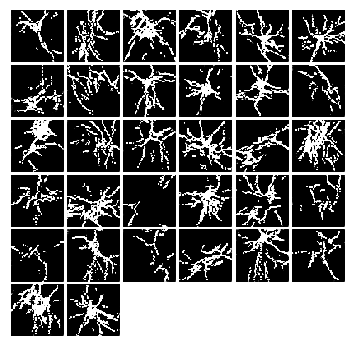


Iter: 2600, D: 0.4351, G:2.068


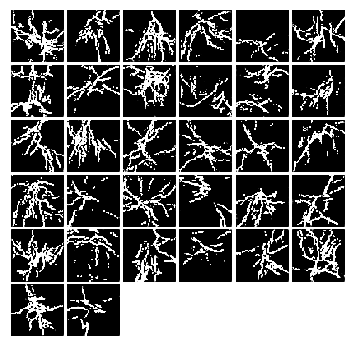


Iter: 2700, D: 0.7016, G:1.451


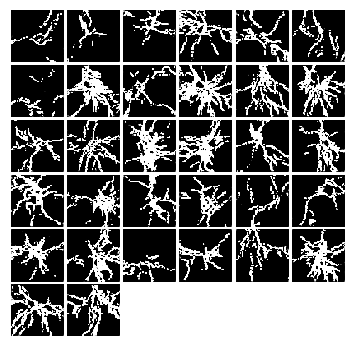


Iter: 2800, D: 0.4529, G:2.116


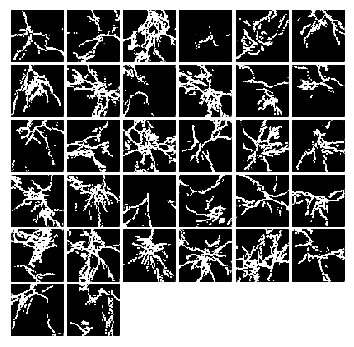


Iter: 2900, D: 0.3771, G:2.893


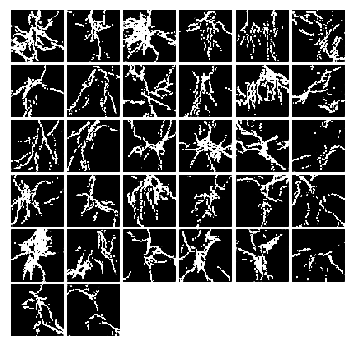


Iter: 3000, D: 109.7, G:0.01307


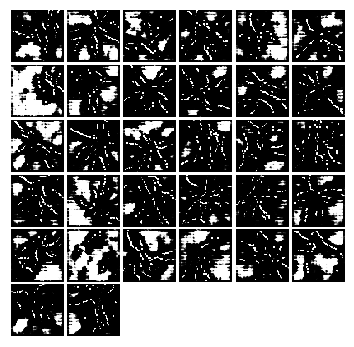


Iter: 3100, D: 0.4242, G:1.725


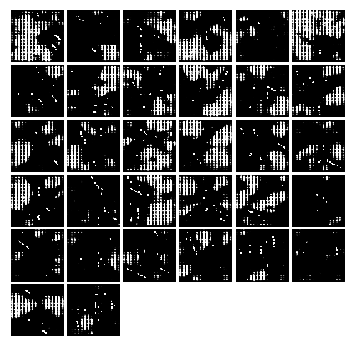


Iter: 3200, D: 0.4534, G:1.881


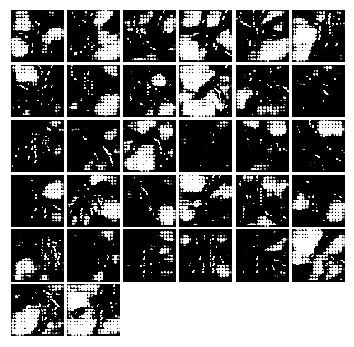


Iter: 3300, D: 0.5661, G:1.804


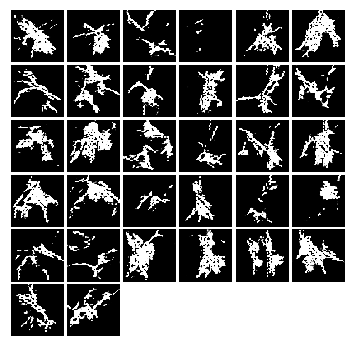


Iter: 3400, D: 0.905, G:1.179


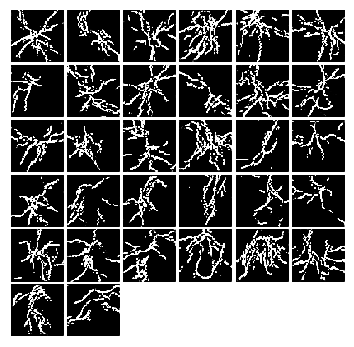


Iter: 3500, D: 0.9591, G:0.8941


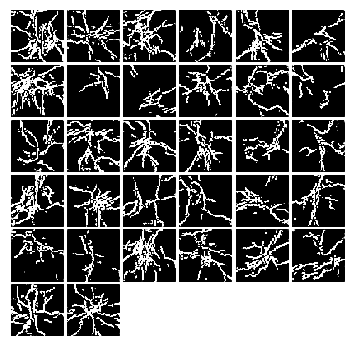


Iter: 3600, D: 0.8517, G:0.8861


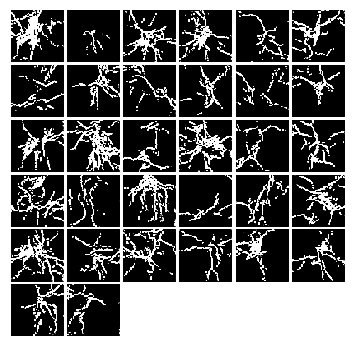


Iter: 3700, D: 2.258, G:1.263


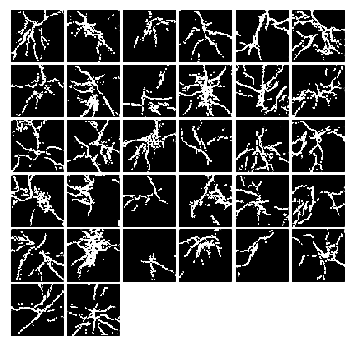


Iter: 3800, D: 0.7051, G:1.18


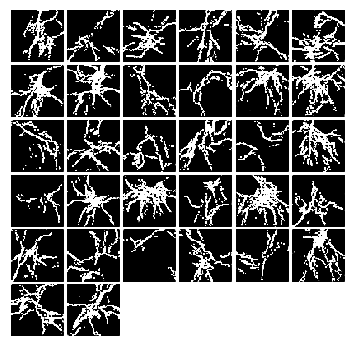


Iter: 3900, D: 3.496, G:1.48


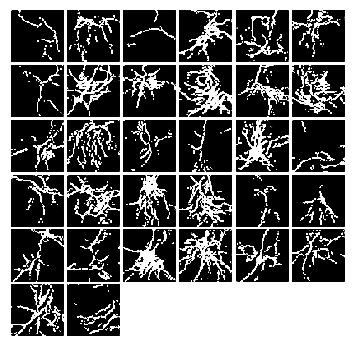


Iter: 4000, D: 0.8223, G:1.111


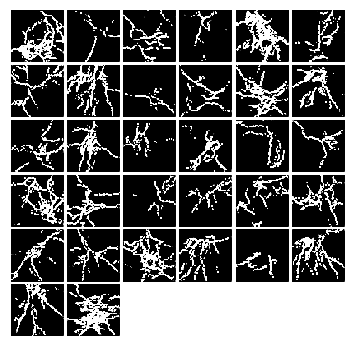


Iter: 4100, D: 0.499, G:1.801


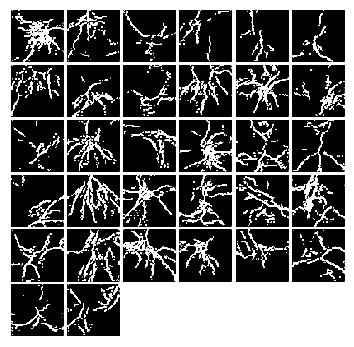


Iter: 4200, D: 4.12, G:1.741


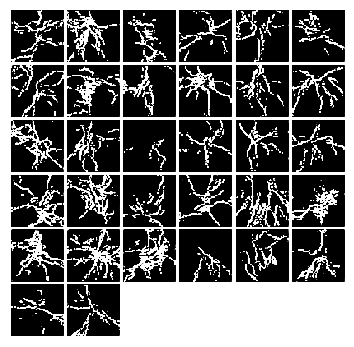


Iter: 4300, D: 0.3798, G:2.199


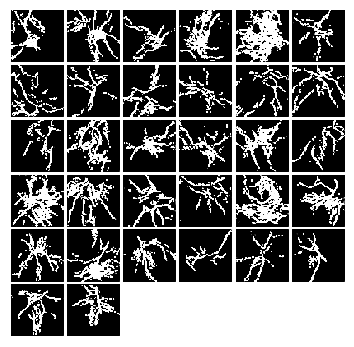


Iter: 4400, D: 0.6094, G:1.45


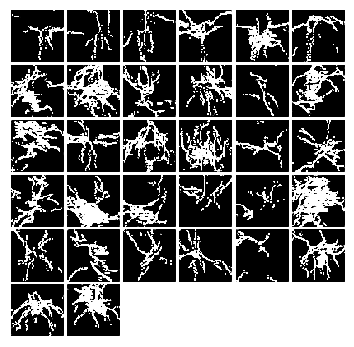


Iter: 4500, D: 0.2934, G:3.067


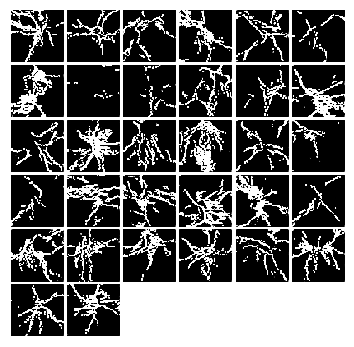


Iter: 4600, D: 0.5403, G:2.352


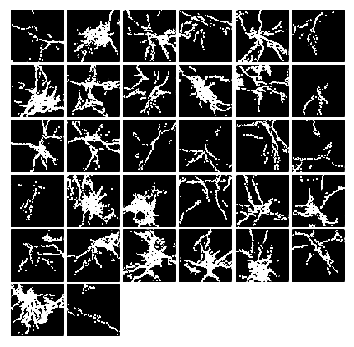


Iter: 4700, D: 0.2867, G:2.594


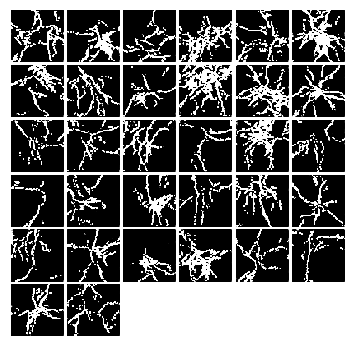


Iter: 4800, D: 0.4761, G:1.866


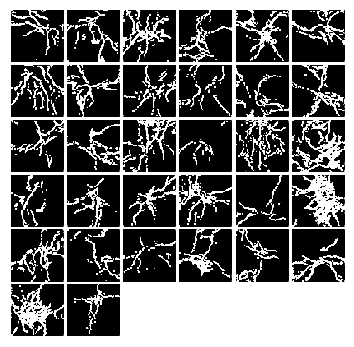


Iter: 4900, D: 0.5089, G:1.918


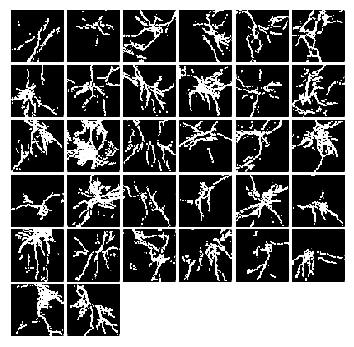


Iter: 5000, D: 0.3327, G:2.258


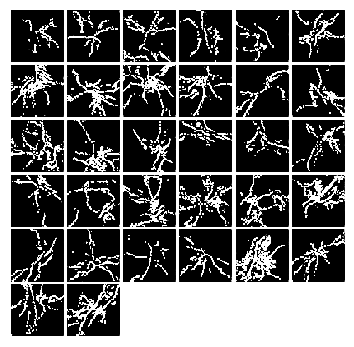


Iter: 5100, D: 0.4826, G:1.661


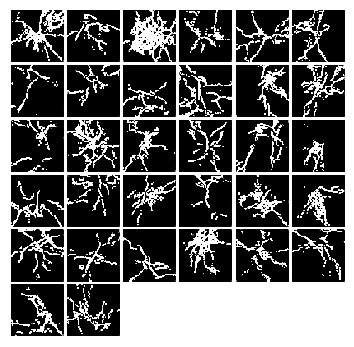


Iter: 5200, D: 0.3267, G:2.532


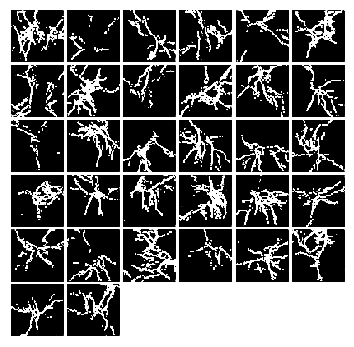


Iter: 5300, D: 0.3642, G:2.334


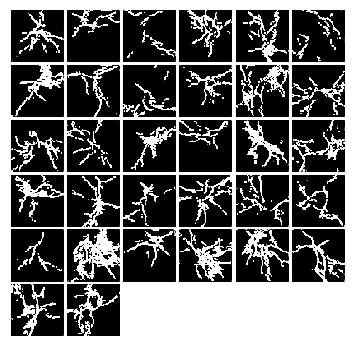


Iter: 5400, D: 0.538, G:1.783


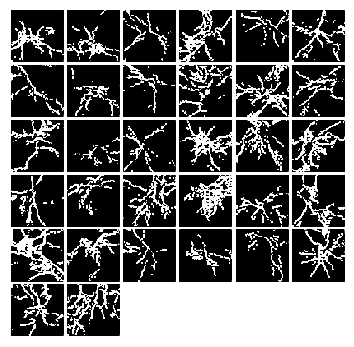


Iter: 5500, D: 0.5642, G:1.664


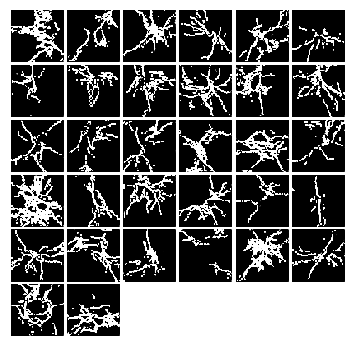


Iter: 5600, D: 0.5234, G:1.792


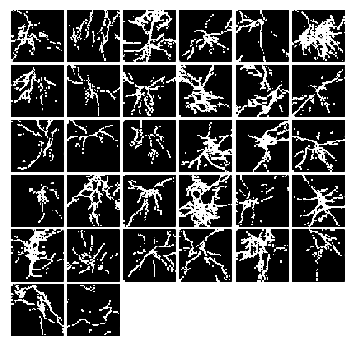


Iter: 5700, D: 0.4439, G:1.816


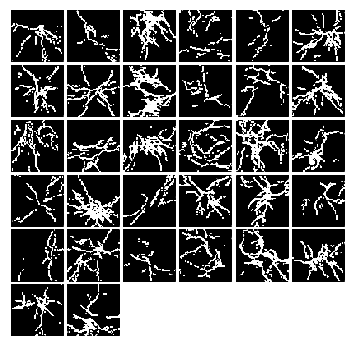


Iter: 5800, D: 0.5576, G:1.409


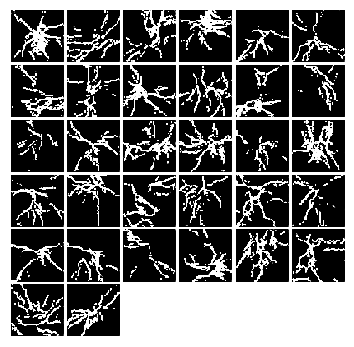


Iter: 5900, D: 0.4375, G:2.089


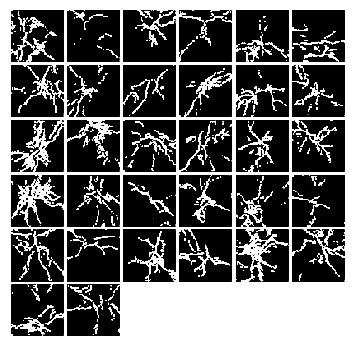


Iter: 6000, D: 0.3654, G:1.87


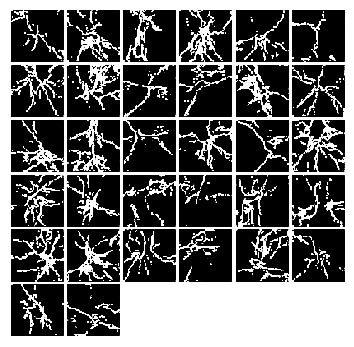


Iter: 6100, D: 0.3443, G:2.535


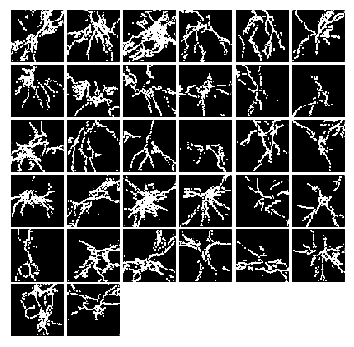


Iter: 6200, D: 0.4676, G:1.801


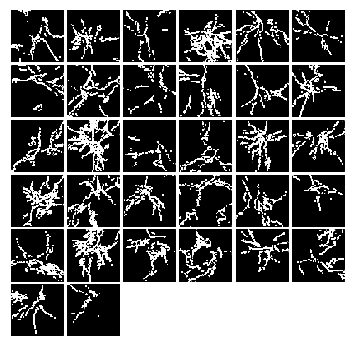


Iter: 6300, D: 0.5106, G:1.653


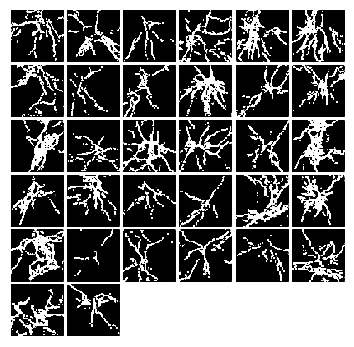


Iter: 6400, D: 0.6828, G:1.509


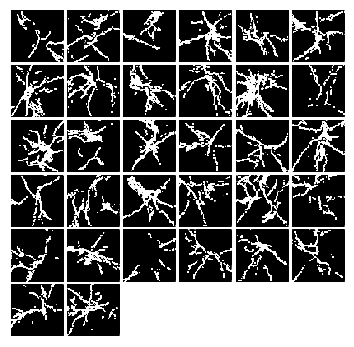


Iter: 6500, D: 0.4267, G:2.216


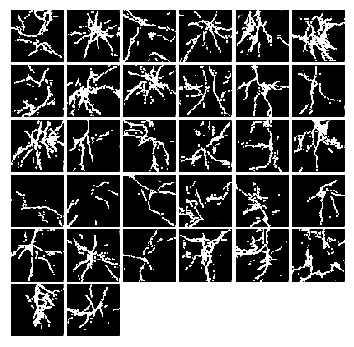


Iter: 6600, D: 0.2809, G:2.939


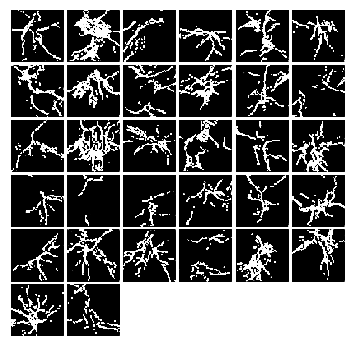


Iter: 6700, D: 0.7079, G:1.316


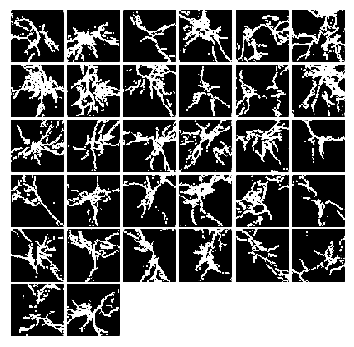


Iter: 6800, D: 0.2125, G:2.85


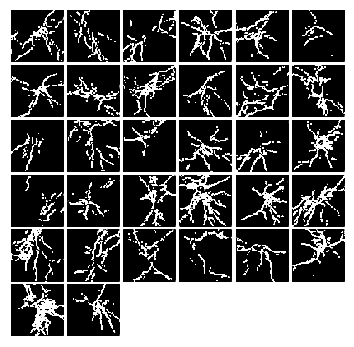


Iter: 6900, D: 2.501, G:1.663


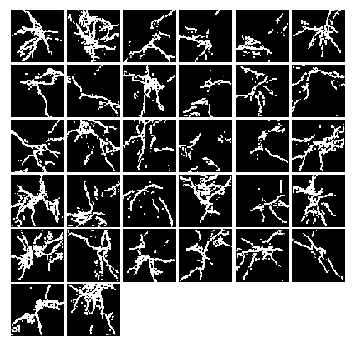


Iter: 7000, D: 0.7348, G:1.873


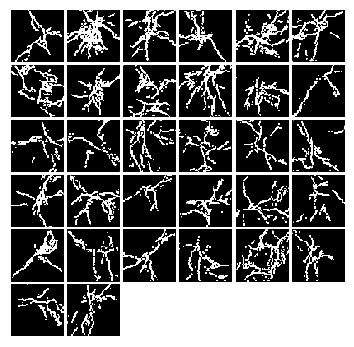


Iter: 7100, D: 0.6281, G:1.562


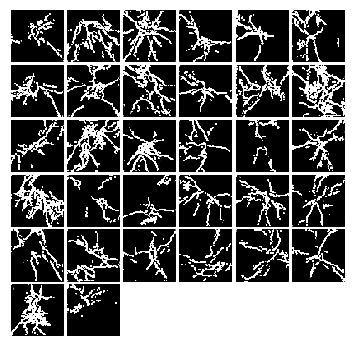


Iter: 7200, D: 0.6571, G:1.412


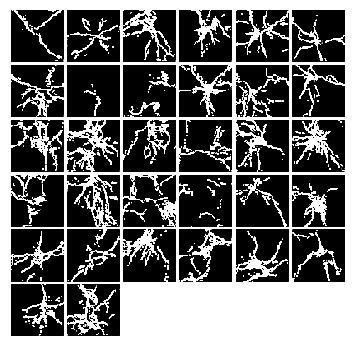


Iter: 7300, D: 0.5053, G:1.886


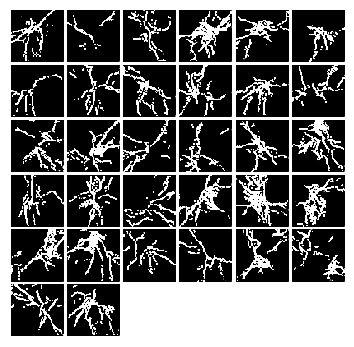


Iter: 7400, D: 0.502, G:1.778


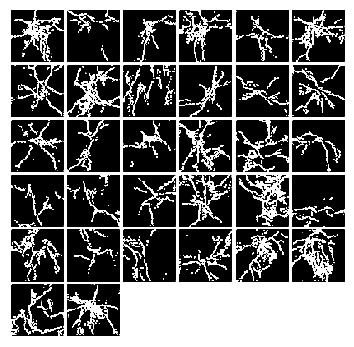


Iter: 7500, D: 0.4476, G:2.167


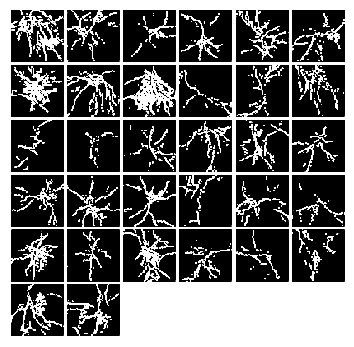


Iter: 7600, D: 2.844, G:1.522


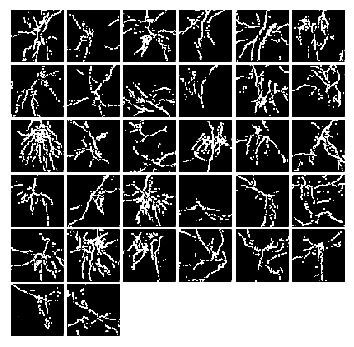


Iter: 7700, D: 3.946, G:1.906


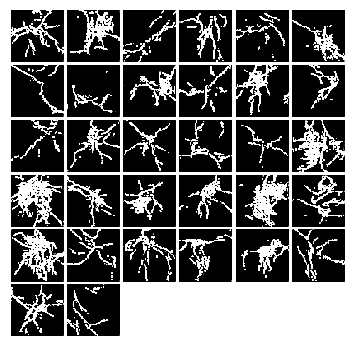


lr-0.0006852589613748453-ls-1-in-1
Iter: 0, D: 1.37, G:0.3909


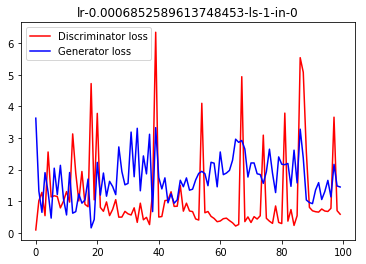

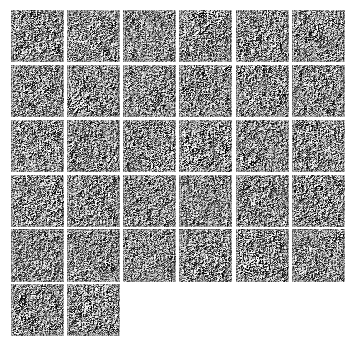


Iter: 100, D: 1.043, G:1.08


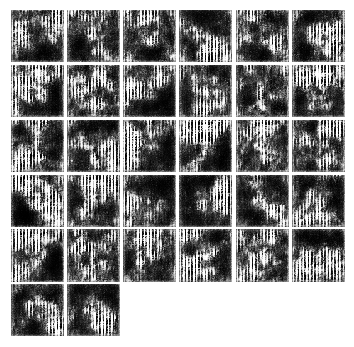


Iter: 200, D: 1.202, G:0.9212


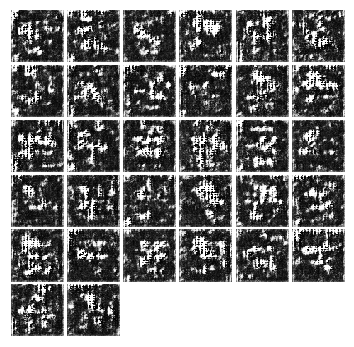


Iter: 300, D: 0.8707, G:1.155


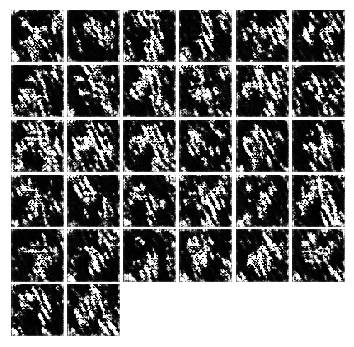


Iter: 400, D: 1.23, G:0.8391


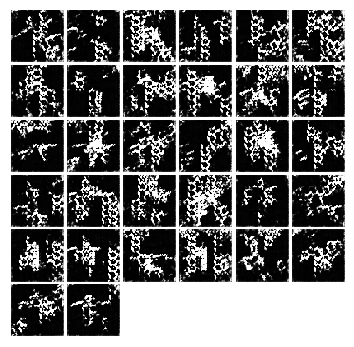


Iter: 500, D: 0.9262, G:1.657


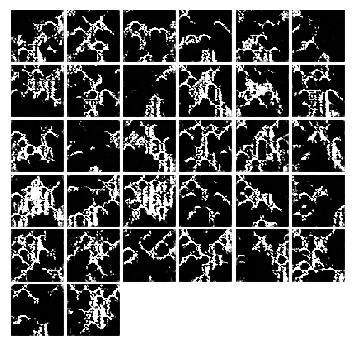


Iter: 600, D: 1.172, G:0.9065


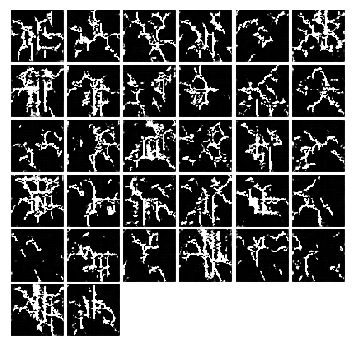


Iter: 700, D: 1.372, G:0.6517


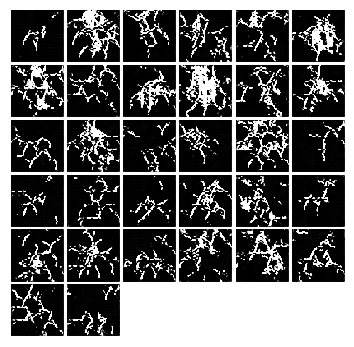


Iter: 800, D: 1.208, G:1.337


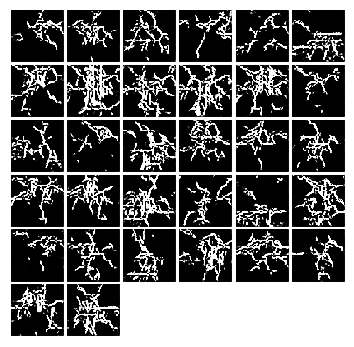


Iter: 900, D: 0.8732, G:1.1


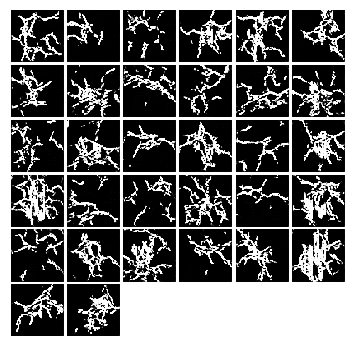


Iter: 1000, D: 1.07, G:0.9093


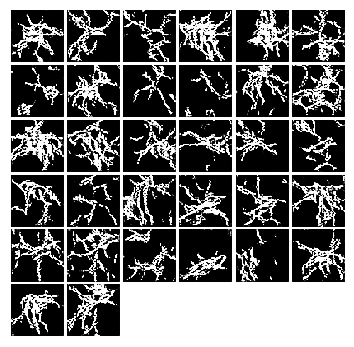


Iter: 1100, D: 0.8972, G:1.001


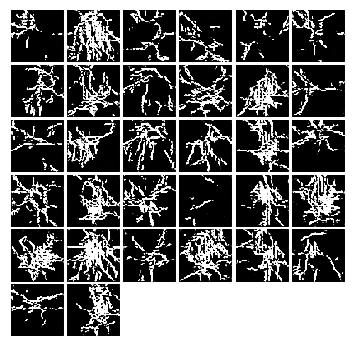


Iter: 1200, D: 0.6511, G:2.026


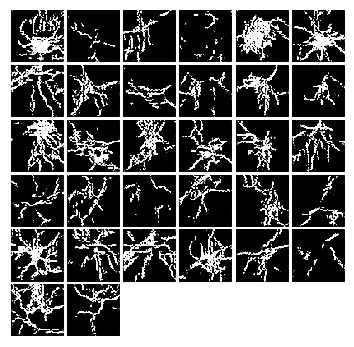


Iter: 1300, D: 0.5725, G:1.854


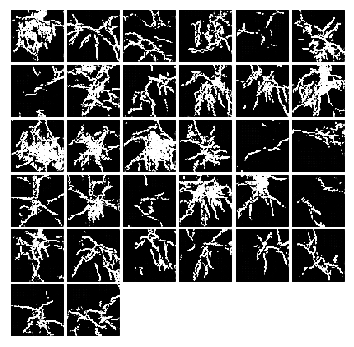


Iter: 1400, D: 0.7162, G:1.771


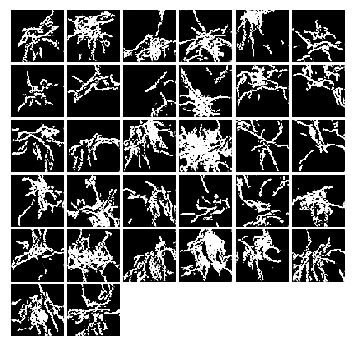


Iter: 1500, D: 0.8768, G:1.032


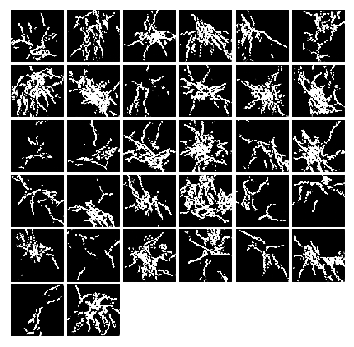


Iter: 1600, D: 0.7608, G:1.214


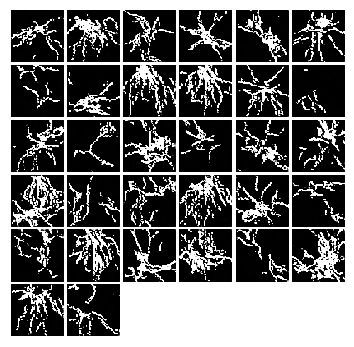


Iter: 1700, D: 0.7085, G:1.916


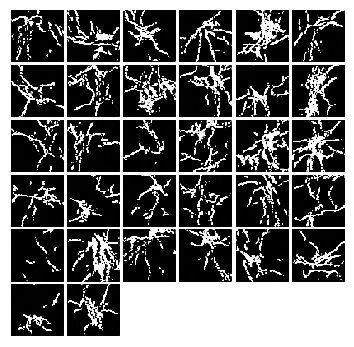


Iter: 1800, D: 0.6045, G:1.541


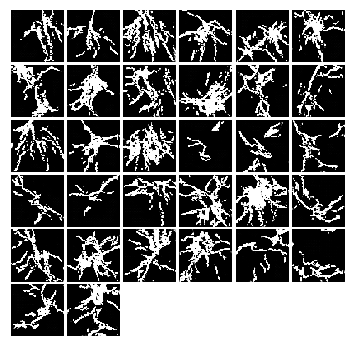


Iter: 1900, D: 0.5639, G:1.475


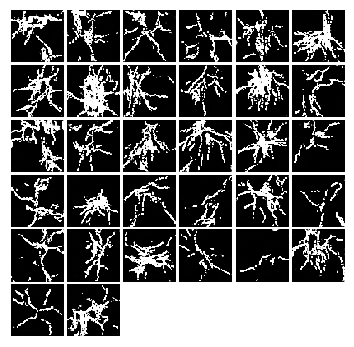


Iter: 2000, D: 0.4318, G:2.018


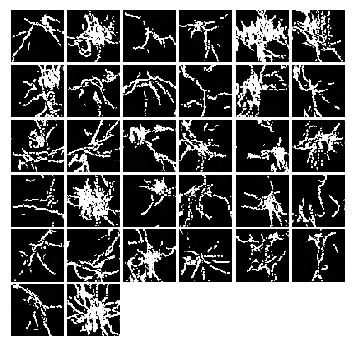


Iter: 2100, D: 3.811, G:1.844


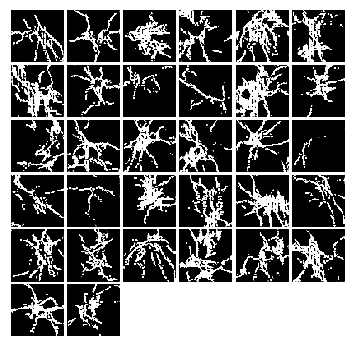


Iter: 2200, D: 2.5, G:0.9693


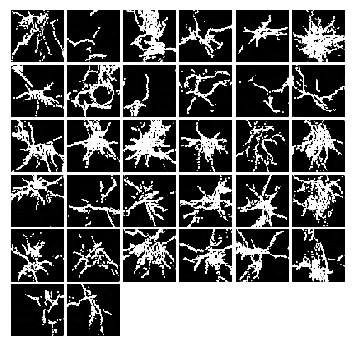


Iter: 2300, D: 1.057, G:2.45


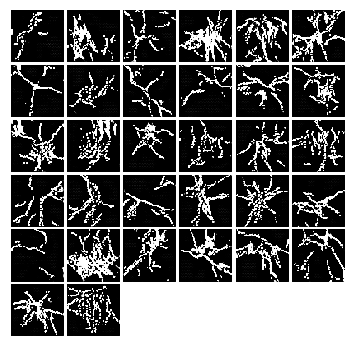


Iter: 2400, D: 0.616, G:1.836


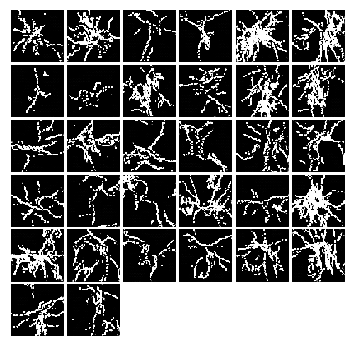


Iter: 2500, D: 0.6125, G:2.3


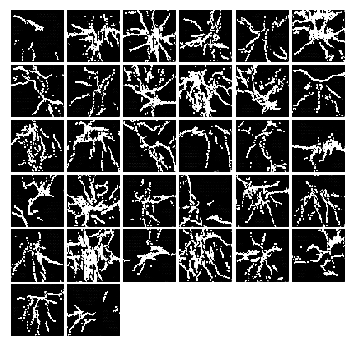


Iter: 2600, D: 0.3371, G:1.531


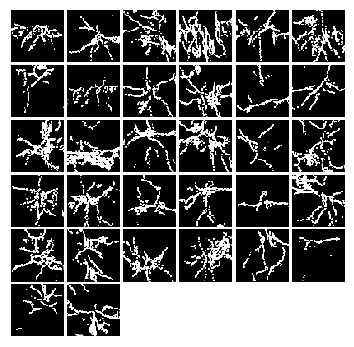


Iter: 2700, D: 0.3426, G:2.418


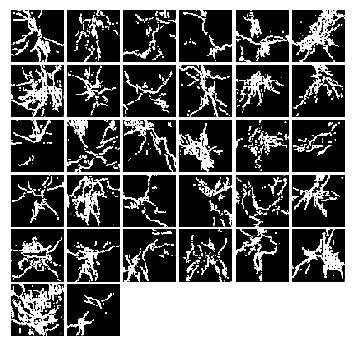


Iter: 2800, D: 0.4718, G:2.142


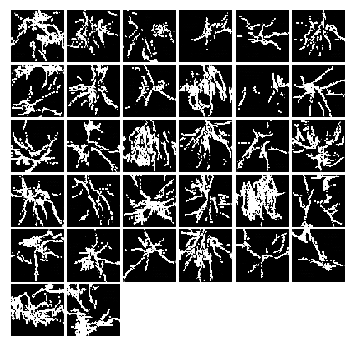


Iter: 2900, D: 3.426, G:1.536


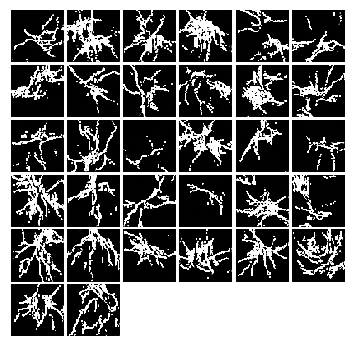


Iter: 3000, D: 0.4001, G:2.138


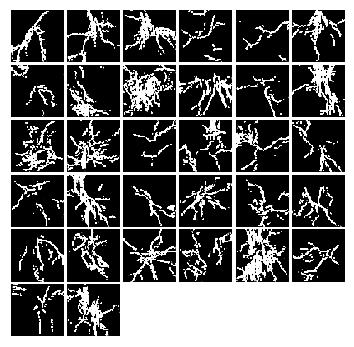


Iter: 3100, D: 0.7148, G:1.517


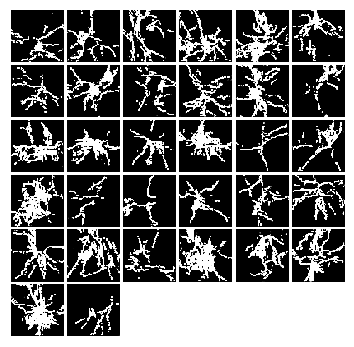


Iter: 3200, D: 3.659, G:1.765


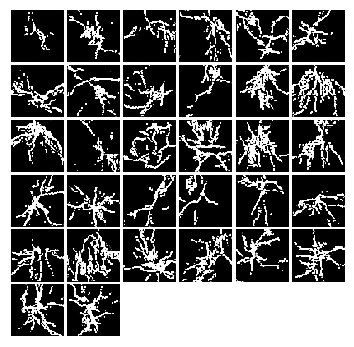


Iter: 3300, D: 0.5666, G:1.461


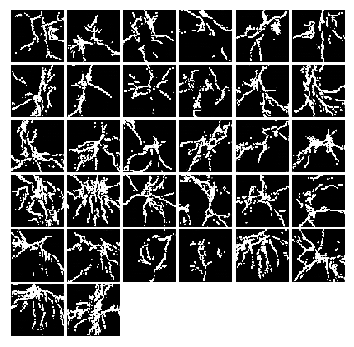


Iter: 3400, D: 0.5824, G:1.313


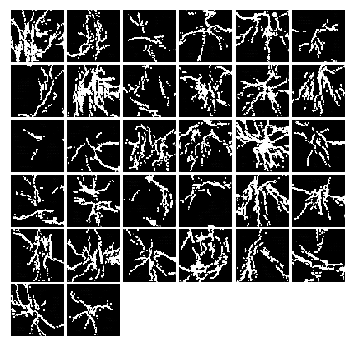


Iter: 3500, D: 0.5912, G:1.884


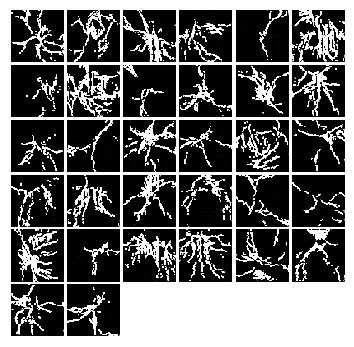


Iter: 3600, D: 0.6055, G:1.48


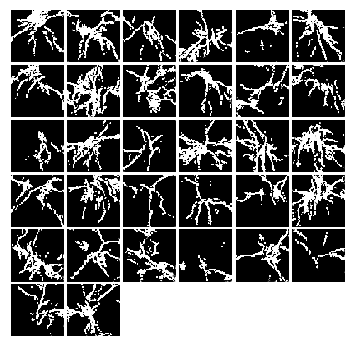


Iter: 3700, D: 0.6473, G:1.391


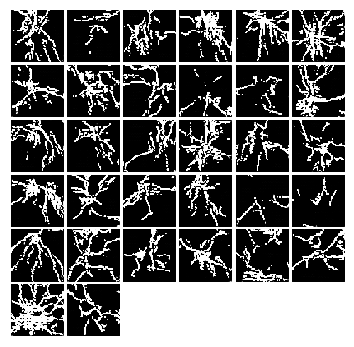


Iter: 3800, D: 0.5076, G:2.08


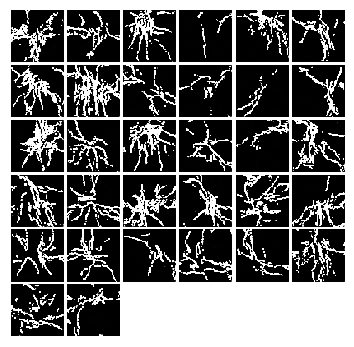


Iter: 3900, D: 0.3563, G:2.424


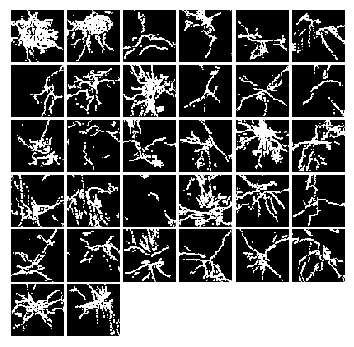


Iter: 4000, D: 0.471, G:1.84


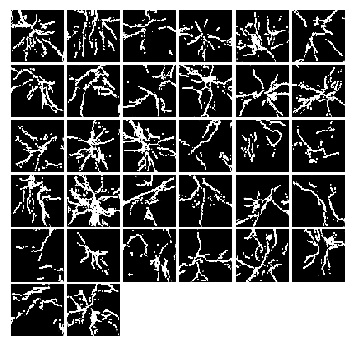


Iter: 4100, D: 0.5439, G:1.711


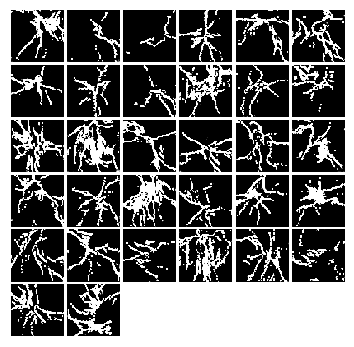


Iter: 4200, D: 0.8099, G:1.446


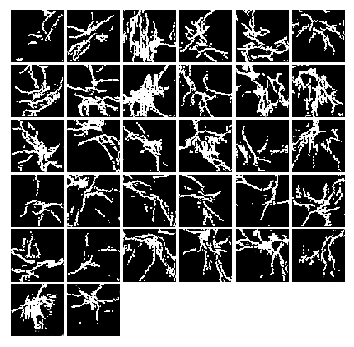


Iter: 4300, D: 0.3333, G:2.582


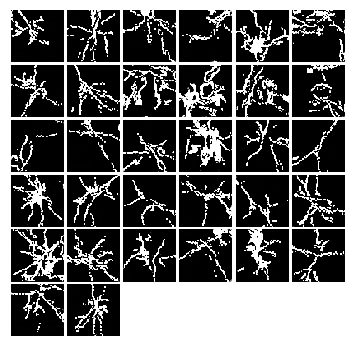


Iter: 4400, D: 0.4698, G:2.079


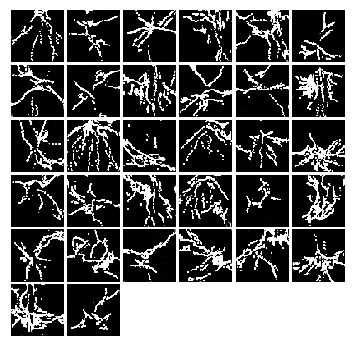


Iter: 4500, D: 0.3843, G:2.106


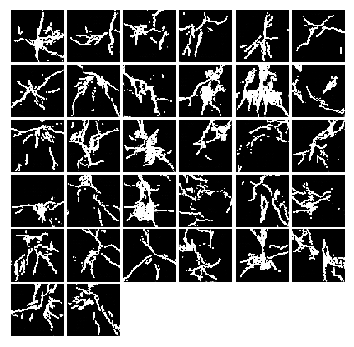


Iter: 4600, D: 0.2807, G:2.669


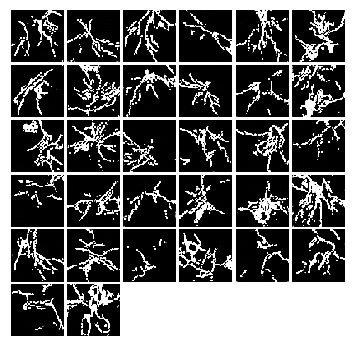


Iter: 4700, D: 0.3425, G:2.099


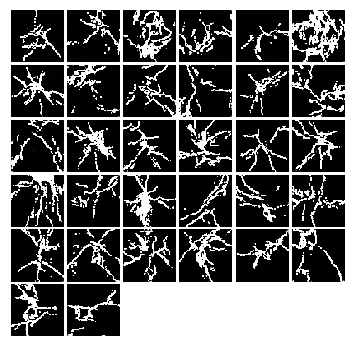


Iter: 4800, D: 0.4172, G:2.19


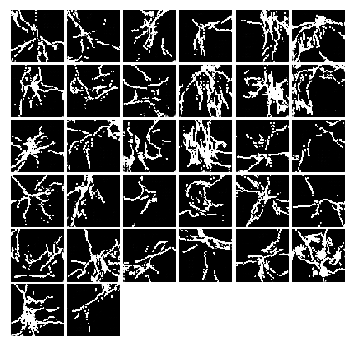


Iter: 4900, D: 0.3594, G:2.264


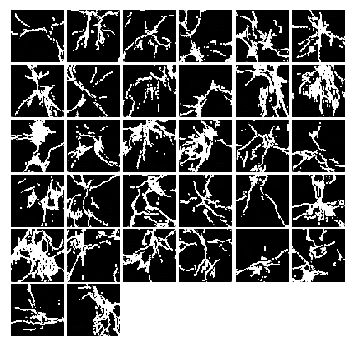


Iter: 5000, D: 0.5992, G:1.455


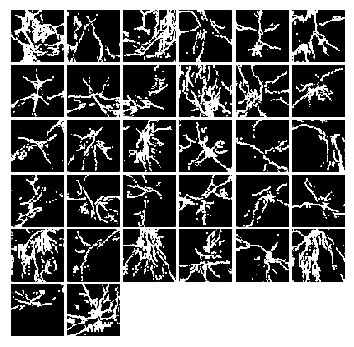


Iter: 5100, D: 0.7577, G:1.29


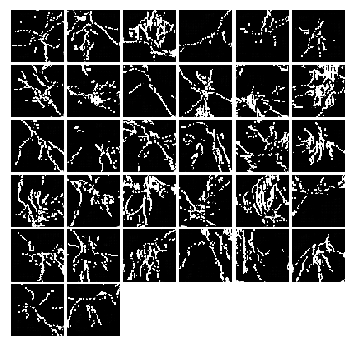


Iter: 5200, D: 0.412, G:1.705


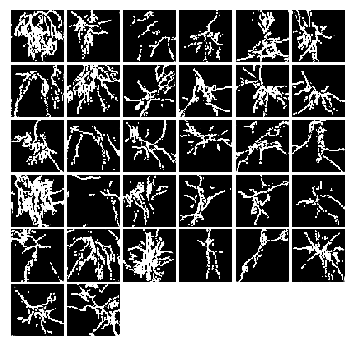


Iter: 5300, D: 0.1231, G:3.264


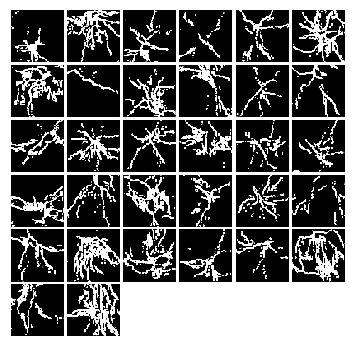


Iter: 5400, D: 0.6512, G:1.538


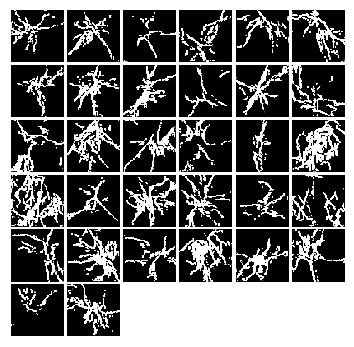


Iter: 5500, D: 0.31, G:2.099


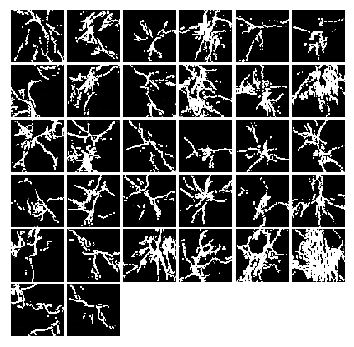


Iter: 5600, D: 0.7399, G:1.289


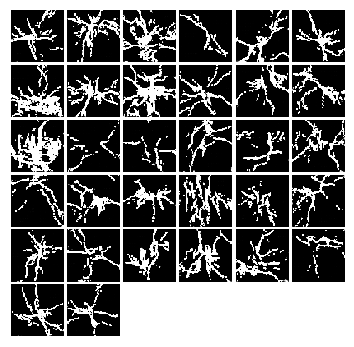


Iter: 5700, D: 0.3856, G:1.896


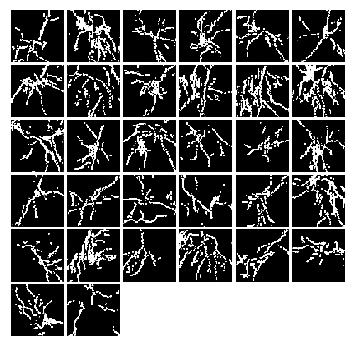


Iter: 5800, D: 0.6728, G:1.755


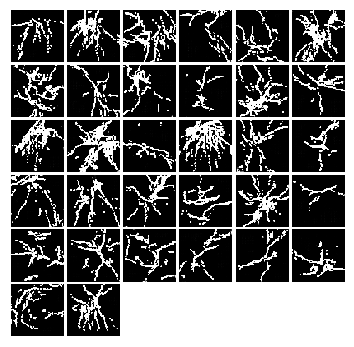


Iter: 5900, D: 0.6201, G:1.444


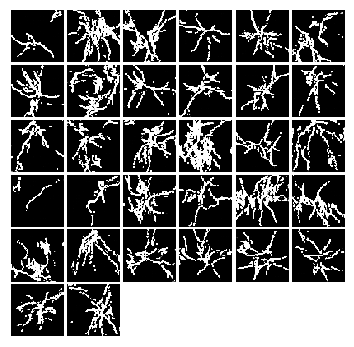


Iter: 6000, D: 0.2854, G:2.276


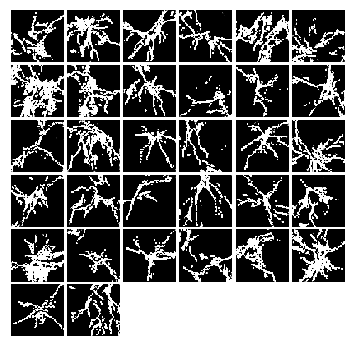


Iter: 6100, D: 0.2876, G:2.285


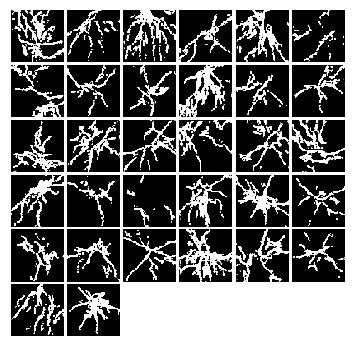


Iter: 6200, D: 0.3247, G:1.986


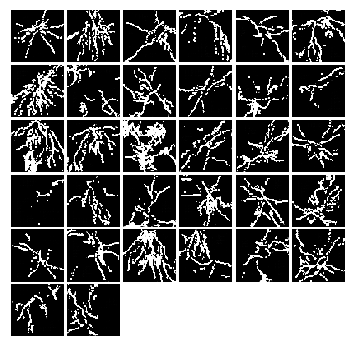


Iter: 6300, D: 0.6696, G:1.625


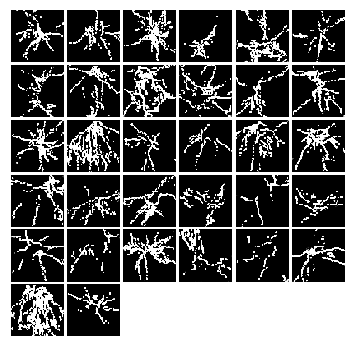


Iter: 6400, D: 4.366, G:2.173


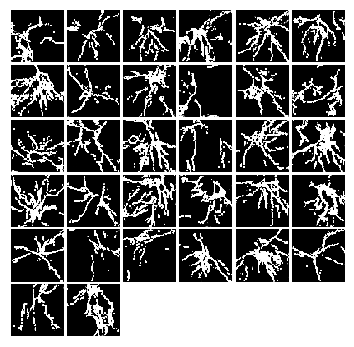


Iter: 6500, D: 0.5248, G:2.16


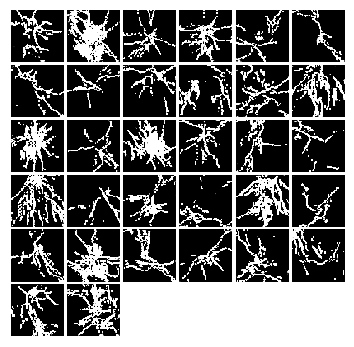


Iter: 6600, D: 0.673, G:1.305


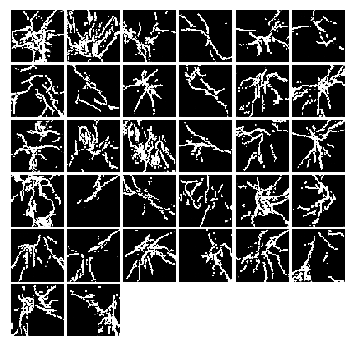


Iter: 6700, D: 0.3106, G:2.467


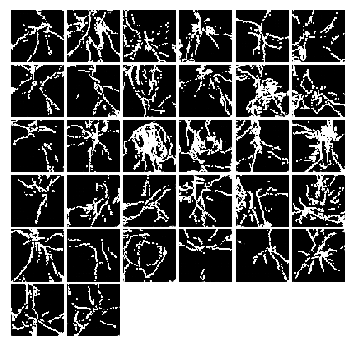


Iter: 6800, D: 4.465, G:2.697


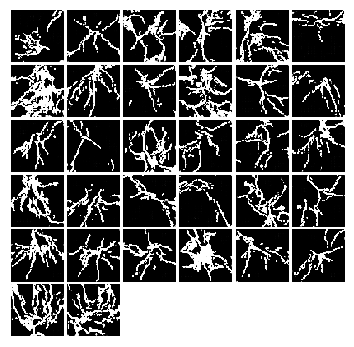


Iter: 6900, D: 0.4517, G:1.594


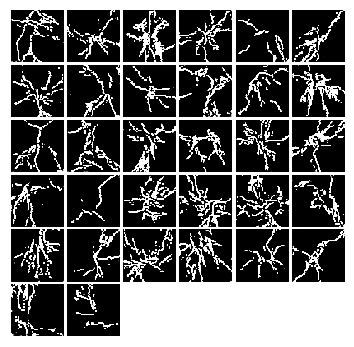


Iter: 7000, D: 0.3832, G:2.196


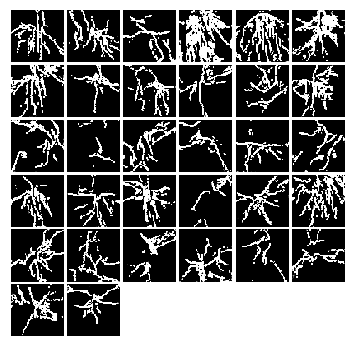


Iter: 7100, D: 3.107, G:1.666


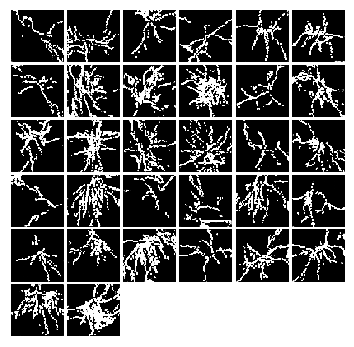


Iter: 7200, D: 0.3998, G:1.979


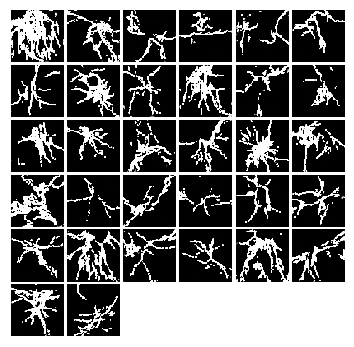


Iter: 7300, D: 0.4202, G:1.832


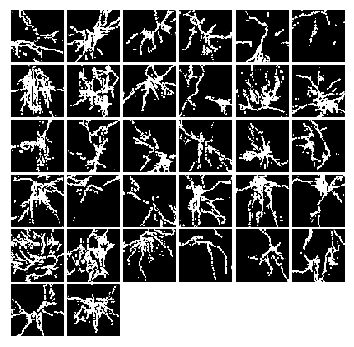


Iter: 7400, D: 0.6264, G:1.449


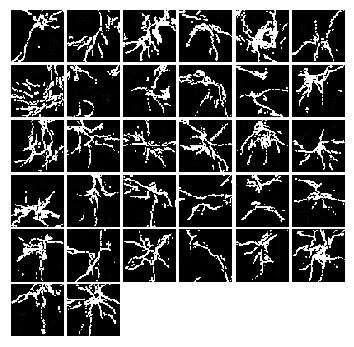


Iter: 7500, D: 0.4245, G:1.686


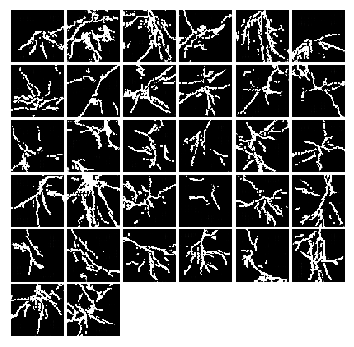


Iter: 7600, D: 0.3398, G:2.09


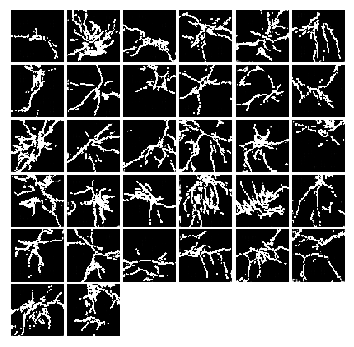


Iter: 7700, D: 0.2478, G:2.73


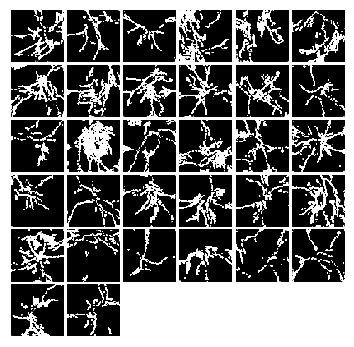

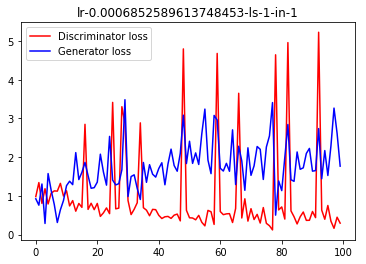

In [17]:

# lr_list = []
# for lr in results_dg.keys():
#     lr_list.append(lr)
# print(lr_list)
# # user needs to pluck out index of ideal learning rate
# ideal_lr_index = 7
# lr_best = lr_list[ideal_lr_index] # 0.0006852589613748453


lr_best = 0.0006852589613748453
dtype = torch.cuda.FloatTensor
print(lr_best)
for i in range(0,2):
    for j in range(0,2):
        title = 'lr-' + str(lr_best) + '-ls-' + str(i) + '-in-' + str(j)
        print(title)
        d_loss_list, g_loss_list, fake_imgs, D, G = dg_gan_run(dtype, lr_best, lr_best, 0.50, 0.999, num_epochs=100, 
                                                       show=True, return_model=True, label_smoothing=i, instance_noise=j)
        plot_loss(d_loss_list, g_loss_list, title=title)
        save_model(D, 'trained-pyramidal-discriminator-ls-'+str(i)+'-in-'+str(j)+'.pt')
        save_model(G, 'trained-pyramidal-generator-ls-'+str(i)+'-in-'+str(j)+'.pt')
